In [1]:
import tensorflow as tf
print(tf.__version__)


1.15.3


In [2]:
import keras 
print(keras.__version__)

2.2.4


Using TensorFlow backend.


In [3]:
#need to run everytime we reload the instance, this allows skimage to convert to LAB and RGB
!pip install --upgrade scikit-image
!pip install --upgrade numpy

     |████████████████████████████████| 12.4 MB 16.3 MB/s eta 0:00:01
     |████████████████████████████████| 147 kB 65.8 MB/s eta 0:00:01
  Attempting uninstall: scikit-image
    Found existing installation: scikit-image 0.16.2
    Uninstalling scikit-image-0.16.2:
      Successfully uninstalled scikit-image-0.16.2
You should consider upgrading via the '/home/ec2-user/anaconda3/envs/tensorflow_p36/bin/python -m pip install --upgrade pip' command.
     |████████████████████████████████| 14.5 MB 18.7 MB/s eta 0:00:01
  Attempting uninstall: numpy
    Found existing installation: numpy 1.18.1
    Uninstalling numpy-1.18.1:
      Successfully uninstalled numpy-1.18.1
You should consider upgrading via the '/home/ec2-user/anaconda3/envs/tensorflow_p36/bin/python -m pip install --upgrade pip' command.


In [4]:
#this enbables tqdm progress bars to show in the notebook
!pip install ipywidgets 
!jupyter nbextension enable --py widgetsnbextension

You should consider upgrading via the '/home/ec2-user/anaconda3/envs/tensorflow_p36/bin/python -m pip install --upgrade pip' command.


Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: OK


In [5]:
#this installs tqdm progress bars
!pip install tqdm

You should consider upgrading via the '/home/ec2-user/anaconda3/envs/tensorflow_p36/bin/python -m pip install --upgrade pip' command.


In [6]:
import re
import os 
import urllib.request
import numpy as np
import random
import pickle
from PIL import Image
from skimage import color
import matplotlib.pyplot as plt
from glob import glob
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Model
from keras.layers import Conv2D, MaxPooling2D, Activation, BatchNormalization, UpSampling2D, Dropout, Flatten, Dense, Input, LeakyReLU, Conv2DTranspose,AveragePooling2D, Concatenate
from keras.models import load_model
from keras.optimizers import Adam
from keras.models import Sequential
from tensorflow.compat.v1 import set_random_seed
import numpy as np
import matplotlib.pyplot as plt
import pickle
import keras.backend as K
import boto3
import time
from copy import deepcopy


# from sagemaker import get_execution_role
%%time
%matplotlib inline

UsageError: Line magic function `%%time` not found.


In [7]:
#import tqdm seperately and use jupyter notebooks %%capture
%%capture
from tqdm import tqdm_notebook as tqdm

UsageError: Line magic function `%%capture` not found.


In [8]:
#enter your bucket name and use boto3 to identify your region if you don't know it
bucket = 'colorization-dataset'
region = boto3.Session().region_name

In [9]:
#add your bucket then creat the containers to download files and send to bucket
from sagemaker import get_execution_role
role = get_execution_role()

bucket = 'colorization-dataset' # customize to your bucket
containers = {'us-west-2': '433757028032.dkr.ecr.us-west-2.amazonaws.com/image-classification:latest',
              'us-east-1': '811284229777.dkr.ecr.us-east-1.amazonaws.com/image-classification:latest',
              'us-east-2': '825641698319.dkr.ecr.us-east-2.amazonaws.com/image-classification:latest',
              'eu-west-1': '685385470294.dkr.ecr.eu-west-1.amazonaws.com/image-classification:latest'}
training_image = containers[boto3.Session().region_name]

In [11]:
# !unzip DataSet -d ./
# !unzip DataSet.zip

Archive:  DataSet.zip
warning [DataSet.zip]:  76 extra bytes at beginning or within zipfile
  (attempting to process anyway)
file #1:  bad zipfile offset (local header sig):  873
  (attempting to re-compensate)
   creating: DataSet/data_256_extra/
   creating: DataSet/data_256_extra/a/
   creating: DataSet/data_256_extra/a/anechoic_chamber/
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_test_00000001.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_test_00000002.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_test_00000003.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_test_00000004.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_test_00000005.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_test_00000006.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_test_00000007.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_test_00000008.jpg  
  inflati

  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000167.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000168.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000169.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000170.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000171.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000172.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000173.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000174.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000175.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000176.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000177.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000178.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000400.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000401.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000402.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000403.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000404.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000405.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000406.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000407.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000408.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000409.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000410.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000411.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000638.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000639.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000640.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000641.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000642.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000643.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000644.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000645.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000646.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000647.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000648.jpg  
  inflating: DataSet/data_256_extra/a/anechoic_chamber/extra_train_00000649.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_test_00000022.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_test_00000023.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_test_00000024.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_test_00000025.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_test_00000026.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_test_00000027.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_test_00000028.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_test_00000029.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_test_00000030.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_test_00000031.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_test_00000032.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/i

  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000159.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000160.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000161.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000162.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000163.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000164.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000165.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000166.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000167.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000168.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000169.jpg  
  inflating: DataSet/data_256_extra/a/athle

  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000401.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000402.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000403.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000404.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000405.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000406.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000407.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000408.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000409.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000410.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000411.jpg  
  inflating: DataSet/data_256_extra/a/athle

  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000638.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000639.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000640.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000641.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000642.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000643.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000644.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000645.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000646.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000647.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000648.jpg  
  inflating: DataSet/data_256_extra/a/athle

  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000886.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000887.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000888.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000889.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000890.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000891.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000892.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000893.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000894.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000895.jpg  
  inflating: DataSet/data_256_extra/a/athletic_field/indoor/extra_train_00000896.jpg  
  inflating: DataSet/data_256_extra/a/athle

  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000013.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000014.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000015.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000016.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000017.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000018.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000019.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000020.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000021.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000022.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000023.jpg  
  inflating: DataSet/data_256_ex

  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000277.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000278.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000279.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000280.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000281.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000282.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000283.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000284.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000285.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000286.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000287.jpg  
  inflating: DataSet/data_256_ex

  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000538.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000539.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000540.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000541.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000542.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000543.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000544.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000545.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000546.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000547.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000548.jpg  
  inflating: DataSet/data_256_ex

  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000802.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000803.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000804.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000805.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000806.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000807.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000808.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000809.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000810.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000811.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00000812.jpg  
  inflating: DataSet/data_256_ex

  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001062.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001063.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001064.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001065.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001066.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001067.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001068.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001069.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001070.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001071.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001072.jpg  
  inflating: DataSet/data_256_ex

  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001321.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001322.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001323.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001324.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001325.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001326.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001327.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001328.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001329.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001330.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001331.jpg  
  inflating: DataSet/data_256_ex

  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001585.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001586.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001587.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001588.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001589.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001590.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001591.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001592.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001593.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001594.jpg  
  inflating: DataSet/data_256_extra/b/badminton_court/indoor/extra_train_00001595.jpg  
  inflating: DataSet/data_256_ex

  inflating: DataSet/data_256_extra/b/baggage_claim/extra_test_00000057.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_test_00000058.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_test_00000059.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_test_00000060.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_test_00000061.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_test_00000062.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_test_00000063.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_test_00000064.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_test_00000065.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_test_00000066.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_test_00000067.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_test_00000068.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_test_0

  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000214.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000215.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000216.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000217.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000218.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000219.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000220.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000221.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000222.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000223.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000224.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000225.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/

  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000480.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000481.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000482.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000483.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000484.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000485.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000486.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000487.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000488.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000489.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000490.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000491.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/

  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000731.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000732.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000733.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000734.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000735.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000736.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000737.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000738.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000739.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000740.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000741.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000742.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/

  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000988.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000989.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000990.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000991.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000992.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000993.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000994.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000995.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000996.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000997.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000998.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00000999.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/

  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001237.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001238.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001239.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001240.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001241.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001242.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001243.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001244.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001245.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001246.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001247.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001248.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/

  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001498.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001499.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001500.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001501.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001502.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001503.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001504.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001505.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001506.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001507.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001508.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001509.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/

  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001761.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001762.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001763.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001764.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001765.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001766.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001767.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001768.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001769.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001770.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001771.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00001772.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/

  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002011.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002012.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002013.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002014.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002015.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002016.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002017.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002018.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002019.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002020.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002021.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002022.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/

  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002256.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002257.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002258.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002259.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002260.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002261.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002262.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002263.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002264.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002265.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002266.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002267.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/

  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002521.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002522.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002523.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002524.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002525.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002526.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002527.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002528.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002529.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002530.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002531.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002532.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/

  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002788.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002789.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002790.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002791.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002792.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002793.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002794.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002795.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002796.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002797.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002798.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00002799.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/

  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003053.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003054.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003055.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003056.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003057.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003058.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003059.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003060.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003061.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003062.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003063.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003064.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/

  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003325.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003326.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003327.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003328.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003329.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003330.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003331.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003332.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003333.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003334.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003335.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/extra_train_00003336.jpg  
  inflating: DataSet/data_256_extra/b/baggage_claim/

  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_test_00000023.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_test_00000024.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_test_00000025.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_test_00000026.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_test_00000027.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_test_00000028.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_test_00000029.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_test_00000030.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_test_00000031.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_test_00000032.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_test_00000033.jpg  
  inflating: DataSet/

  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000186.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000187.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000188.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000189.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000190.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000191.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000192.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000193.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000194.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000195.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000196.jpg  
  inflatin

  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000439.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000440.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000441.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000442.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000443.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000444.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000445.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000446.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000447.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000448.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000449.jpg  
  inflatin

  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000687.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000688.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000689.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000690.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000691.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000692.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000693.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000694.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000695.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000696.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000697.jpg  
  inflatin

  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000947.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000948.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000949.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000950.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000951.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000952.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000953.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000954.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000955.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000956.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00000957.jpg  
  inflatin

  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001198.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001199.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001200.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001201.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001202.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001203.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001204.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001205.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001206.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001207.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001208.jpg  
  inflatin

  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001322.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001323.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001324.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001325.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001326.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001327.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001328.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001329.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001330.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001331.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001332.jpg  
  inflatin

  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001484.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001485.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001486.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001487.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001488.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001489.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001490.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001491.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001492.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001493.jpg  
  inflating: DataSet/data_256_extra/b/basketball_court/outdoor/extra_train_00001494.jpg  
  inflatin

  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000077.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000078.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000079.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000080.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000081.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000082.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000083.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000084.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000085.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000086.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000087.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000088.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000089.jpg  

  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000309.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000310.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000311.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000312.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000313.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000314.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000315.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000316.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000317.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000318.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000319.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000320.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000321.jpg  

  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000546.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000547.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000548.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000549.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000550.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000551.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000552.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000553.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000554.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000555.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000556.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000557.jpg  
  inflating: DataSet/data_256_extra/b/batters_box/extra_train_00000558.jpg  

  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_test_00000087.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_test_00000088.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_test_00000089.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_test_00000090.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_test_00000091.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_test_00000092.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_test_00000093.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_test_00000094.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_test_00000095.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_test_00000096.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_test_00000097.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_test_00000098.jpg  
  in

  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000228.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000229.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000230.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000231.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000232.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000233.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000234.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000235.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000236.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000237.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000238.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_0000023

  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000460.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000461.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000462.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000463.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000464.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000465.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000466.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000467.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000468.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000469.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000470.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_0000047

  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000686.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000687.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000688.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000689.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000690.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000691.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000692.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000693.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000694.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000695.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_00000696.jpg  
  inflating: DataSet/data_256_extra/b/bow_window/outdoor/extra_train_0000069

  inflating: DataSet/data_256_extra/b/brewery/indoor/extra_train_00000044.jpg  
  inflating: DataSet/data_256_extra/b/brewery/indoor/extra_train_00000045.jpg  
  inflating: DataSet/data_256_extra/b/brewery/indoor/extra_train_00000046.jpg  
  inflating: DataSet/data_256_extra/b/brewery/indoor/extra_train_00000047.jpg  
  inflating: DataSet/data_256_extra/b/brewery/indoor/extra_train_00000048.jpg  
  inflating: DataSet/data_256_extra/b/brewery/indoor/extra_train_00000049.jpg  
  inflating: DataSet/data_256_extra/b/brewery/indoor/extra_train_00000050.jpg  
  inflating: DataSet/data_256_extra/b/brewery/indoor/extra_train_00000051.jpg  
  inflating: DataSet/data_256_extra/b/brewery/indoor/extra_train_00000052.jpg  
  inflating: DataSet/data_256_extra/b/brewery/indoor/extra_train_00000053.jpg  
  inflating: DataSet/data_256_extra/b/brewery/indoor/extra_train_00000054.jpg  
  inflating: DataSet/data_256_extra/b/brewery/indoor/extra_train_00000055.jpg  
  inflating: DataSet/data_256_extra/b/br

  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000090.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000091.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000092.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000093.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000094.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000095.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000096.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000097.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000098.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000099.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000100.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000101.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/

  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000336.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000337.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000338.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000339.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000340.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000341.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000342.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000343.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000344.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000345.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000346.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000347.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/

  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000566.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000567.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000568.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000569.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000570.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000571.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000572.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000573.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000574.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000575.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000576.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000577.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/

  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000791.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000792.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000793.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000794.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000795.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000796.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000797.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000798.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000799.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000800.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000801.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00000802.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/

  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001029.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001030.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001031.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001032.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001033.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001034.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001035.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001036.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001037.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001038.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001039.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001040.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/

  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001258.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001259.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001260.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001261.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001262.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001263.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001264.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001265.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001266.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001267.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001268.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001269.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/

  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001493.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001494.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001495.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001496.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001497.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001498.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001499.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001500.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001501.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001502.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001503.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001504.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/

  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001726.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001727.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001728.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001729.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001730.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001731.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001732.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001733.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001734.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001735.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001736.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001737.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/

  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001959.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001960.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001961.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001962.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001963.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001964.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001965.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001966.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001967.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001968.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001969.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00001970.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/

  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00002184.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00002185.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00002186.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00002187.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00002188.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00002189.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00002190.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00002191.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00002192.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00002193.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00002194.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/extra_train_00002195.jpg  
  inflating: DataSet/data_256_extra/c/casino/indoor/

  inflating: DataSet/data_256_extra/c/cheese_factory/extra_test_00000094.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_test_00000095.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_test_00000096.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_test_00000097.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_test_00000098.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_test_00000099.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_test_00000100.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000001.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000002.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000003.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000004.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000005.jpg  
  inflating: DataSet/data_256_extra/c/cheese_fa

  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000232.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000233.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000234.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000235.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000236.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000237.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000238.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000239.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000240.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000241.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000242.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000243.jpg  
  inflating: DataSet/data_256_extra/c/ch

  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000478.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000479.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000480.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000481.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000482.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000483.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000484.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000485.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000486.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000487.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000488.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000489.jpg  
  inflating: DataSet/data_256_extra/c/ch

  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000718.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000719.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000720.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000721.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000722.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000723.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000724.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000725.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000726.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000727.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000728.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000729.jpg  
  inflating: DataSet/data_256_extra/c/ch

  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000963.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000964.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000965.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000966.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000967.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000968.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000969.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000970.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000971.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000972.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000973.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00000974.jpg  
  inflating: DataSet/data_256_extra/c/ch

  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001204.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001205.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001206.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001207.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001208.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001209.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001210.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001211.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001212.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001213.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001214.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001215.jpg  
  inflating: DataSet/data_256_extra/c/ch

  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001447.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001448.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001449.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001450.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001451.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001452.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001453.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001454.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001455.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001456.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001457.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001458.jpg  
  inflating: DataSet/data_256_extra/c/ch

  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001702.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001703.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001704.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001705.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001706.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001707.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001708.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001709.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001710.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001711.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001712.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001713.jpg  
  inflating: DataSet/data_256_extra/c/ch

  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001963.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001964.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001965.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001966.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001967.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001968.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001969.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001970.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001971.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001972.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001973.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00001974.jpg  
  inflating: DataSet/data_256_extra/c/ch

  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002230.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002231.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002232.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002233.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002234.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002235.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002236.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002237.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002238.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002239.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002240.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002241.jpg  
  inflating: DataSet/data_256_extra/c/ch

  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002486.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002487.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002488.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002489.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002490.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002491.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002492.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002493.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002494.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002495.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002496.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002497.jpg  
  inflating: DataSet/data_256_extra/c/ch

  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002713.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002714.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002715.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002716.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002717.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002718.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002719.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002720.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002721.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002722.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002723.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00002724.jpg  
  inflating: DataSet/data_256_extra/c/ch

  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00003052.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00003053.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00003054.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00003055.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00003056.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00003057.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00003058.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00003059.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00003060.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00003061.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00003062.jpg  
  inflating: DataSet/data_256_extra/c/cheese_factory/extra_train_00003063.jpg  
  inflating: DataSet/data_256_extra/c/ch

  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000020.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000021.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000022.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000023.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000024.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000025.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000026.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000027.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000028.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000029.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000030.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/out

  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000247.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000248.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000249.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000250.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000251.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000252.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000253.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000254.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000255.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000256.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000257.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/out

  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000472.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000473.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000474.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000475.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000476.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000477.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000478.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000479.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000480.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000481.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/outdoor/extra_train_00000482.jpg  
  inflating: DataSet/data_256_extra/c/chicken_coop/out

  inflating: DataSet/data_256_extra/c/courtroom/extra_test_00000020.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_test_00000021.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_test_00000022.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_test_00000023.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_test_00000024.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_test_00000025.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_test_00000026.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_test_00000027.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_test_00000028.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_test_00000029.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_test_00000030.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_test_00000031.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_test_00000032.jpg  
  inflating: DataSet/data_256_extra/c/

  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000192.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000193.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000194.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000195.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000196.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000197.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000198.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000199.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000200.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000201.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000202.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000203.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000204.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000488.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000489.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000490.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000491.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000492.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000493.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000494.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000495.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000496.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000497.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000498.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000499.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000500.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000752.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000753.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000754.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000755.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000756.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000757.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000758.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000759.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000760.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000761.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000762.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000763.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00000764.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001026.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001027.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001028.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001029.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001030.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001031.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001032.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001033.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001034.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001035.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001036.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001037.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001038.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001303.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001304.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001305.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001306.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001307.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001308.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001309.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001310.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001311.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001312.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001313.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001314.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001315.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001578.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001579.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001580.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001581.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001582.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001583.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001584.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001585.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001586.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001587.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001588.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001589.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001590.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001858.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001859.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001860.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001861.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001862.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001863.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001864.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001865.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001866.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001867.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001868.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001869.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00001870.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002125.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002126.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002127.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002128.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002129.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002130.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002131.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002132.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002133.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002134.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002135.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002136.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002137.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002406.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002407.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002408.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002409.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002410.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002411.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002412.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002413.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002414.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002415.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002416.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002417.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002418.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002679.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002680.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002681.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002682.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002683.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002684.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002685.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002686.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002687.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002688.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002689.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002690.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002691.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002949.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002950.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002951.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002952.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002953.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002954.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002955.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002956.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002957.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002958.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002959.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002960.jpg  
  inflating: DataSet/data_256_extra/c/courtroom/extra_train_00002961.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_test_00000097.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_test_00000098.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_test_00000099.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_test_00000100.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000001.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000002.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000003.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000004.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000005.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000006.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000007.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000231.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000232.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000233.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000234.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000235.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000236.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000237.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000238.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000239.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000240.jpg  
  inflating: DataSet/data_256_extra/c/covered_bridge/exterior/extra_train_00000241.jpg  
  inflating: DataSet/

  inflating: DataSet/data_256_extra/c/cybercafe/extra_test_00000008.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_test_00000009.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_test_00000010.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_test_00000011.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_test_00000012.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_test_00000013.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_test_00000014.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_test_00000015.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_test_00000016.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_test_00000017.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_test_00000018.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_test_00000019.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_test_00000020.jpg  
  inflating: DataSet/data_256_extra/c/

  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000166.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000167.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000168.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000169.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000170.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000171.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000172.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000173.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000174.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000175.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000176.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000177.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000178.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000422.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000423.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000424.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000425.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000426.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000427.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000428.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000429.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000430.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000431.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000432.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000433.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000434.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000681.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000682.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000683.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000684.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000685.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000686.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000687.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000688.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000689.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000690.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000691.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000692.jpg  
  inflating: DataSet/data_256_extra/c/cybercafe/extra_train_00000693.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/d/dentists_office/extra_test_00000015.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_test_00000016.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_test_00000017.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_test_00000018.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_test_00000019.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_test_00000020.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_test_00000021.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_test_00000022.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_test_00000023.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_test_00000024.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_test_00000025.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_test_00000026.jpg  
  inflating: DataSet/data_256_extra/d/de

  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000182.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000183.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000184.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000185.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000186.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000187.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000188.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000189.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000190.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000191.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000192.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000193.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000464.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000465.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000466.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000467.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000468.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000469.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000470.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000471.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000472.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000473.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000474.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000475.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000749.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000750.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000751.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000752.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000753.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000754.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000755.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000756.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000757.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000758.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000759.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00000760.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001040.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001041.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001042.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001043.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001044.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001045.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001046.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001047.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001048.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001049.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001050.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001051.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001194.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001195.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001196.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001197.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001198.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001199.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001200.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001201.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001202.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001203.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001204.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001205.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001463.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001464.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001465.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001466.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001467.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001468.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001469.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001470.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001471.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001472.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001473.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001474.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001733.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001734.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001735.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001736.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001737.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001738.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001739.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001740.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001741.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001742.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001743.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00001744.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002000.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002001.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002002.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002003.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002004.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002005.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002006.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002007.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002008.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002009.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002010.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002011.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002272.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002273.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002274.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002275.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002276.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002277.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002278.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002279.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002280.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002281.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002282.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002283.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002559.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002560.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002561.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002562.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002563.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002564.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002565.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002566.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002567.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002568.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002569.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002570.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002866.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002867.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002868.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002869.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002870.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002871.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002872.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002873.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002874.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002875.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002876.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00002877.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003144.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003145.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003146.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003147.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003148.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003149.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003150.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003151.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003152.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003153.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003154.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003155.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003423.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003424.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003425.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003426.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003427.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003428.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003429.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003430.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003431.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003432.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003433.jpg  
  inflating: DataSet/data_256_extra/d/dentists_office/extra_train_00003434.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000036.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000037.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000038.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000039.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000040.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000041.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000042.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000043.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000044.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000045.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000046.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000047.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000291.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000292.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000293.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000294.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000295.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000296.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000297.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000298.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000299.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000300.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000301.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000302.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000541.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000542.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000543.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000544.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000545.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000546.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000547.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000548.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000549.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000550.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000551.jpg  
  inflating: DataSet/data_256_extra/d/dinette/vehicle/extra_train_00000552.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000061.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000062.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000063.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000064.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000065.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000066.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000067.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000068.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000069.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000070.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000071.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000072.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000073.jpg  
  inflating:

  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000310.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000311.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000312.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000313.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000314.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000315.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000316.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000317.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000318.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000319.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000320.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000321.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000322.jpg  
  inflating:

  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000558.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000559.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000560.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000561.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000562.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000563.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000564.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000565.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000566.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000567.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000568.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000569.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000570.jpg  
  inflating:

  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000797.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000798.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000799.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000800.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000801.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000802.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000803.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000804.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000805.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000806.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000807.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000808.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00000809.jpg  
  inflating:

  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001033.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001034.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001035.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001036.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001037.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001038.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001039.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001040.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001041.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001042.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001043.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001044.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001045.jpg  
  inflating:

  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001299.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001300.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001301.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001302.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001303.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001304.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001305.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001306.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001307.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001308.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001309.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001310.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001311.jpg  
  inflating:

  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001552.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001553.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001554.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001555.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001556.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001557.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001558.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001559.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001560.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001561.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001562.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001563.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001564.jpg  
  inflating:

  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001798.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001799.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001800.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001801.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001802.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001803.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001804.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001805.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001806.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001807.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001808.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001809.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00001810.jpg  
  inflating:

  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002046.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002047.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002048.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002049.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002050.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002051.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002052.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002053.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002054.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002055.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002056.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002057.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002058.jpg  
  inflating:

  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002289.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002290.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002291.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002292.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002293.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002294.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002295.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002296.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002297.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002298.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002299.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002300.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002301.jpg  
  inflating:

  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002546.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002547.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002548.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002549.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002550.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002551.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002552.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002553.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002554.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002555.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002556.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002557.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002558.jpg  
  inflating:

  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002790.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002791.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002792.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002793.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002794.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002795.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002796.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002797.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002798.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002799.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002800.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002801.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00002802.jpg  
  inflating:

  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00003051.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00003052.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00003053.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00003054.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00003055.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00003056.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00003057.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00003058.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00003059.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00003060.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00003061.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00003062.jpg  
  inflating: DataSet/data_256_extra/d/dining_car/extra_train_00003063.jpg  
  inflating:

  inflating: DataSet/data_256_extra/d/driving_range/outdoor/extra_test_00000075.jpg  
  inflating: DataSet/data_256_extra/d/driving_range/outdoor/extra_test_00000076.jpg  
  inflating: DataSet/data_256_extra/d/driving_range/outdoor/extra_test_00000077.jpg  
  inflating: DataSet/data_256_extra/d/driving_range/outdoor/extra_test_00000078.jpg  
  inflating: DataSet/data_256_extra/d/driving_range/outdoor/extra_test_00000079.jpg  
  inflating: DataSet/data_256_extra/d/driving_range/outdoor/extra_test_00000080.jpg  
  inflating: DataSet/data_256_extra/d/driving_range/outdoor/extra_test_00000081.jpg  
  inflating: DataSet/data_256_extra/d/driving_range/outdoor/extra_test_00000082.jpg  
  inflating: DataSet/data_256_extra/d/driving_range/outdoor/extra_test_00000083.jpg  
  inflating: DataSet/data_256_extra/d/driving_range/outdoor/extra_test_00000084.jpg  
  inflating: DataSet/data_256_extra/d/driving_range/outdoor/extra_test_00000085.jpg  
  inflating: DataSet/data_256_extra/d/driving_range/ou

  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000034.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000035.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000036.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000037.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000038.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000039.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000040.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000041.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000042.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000043.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000044.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000045.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_0

  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000281.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000282.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000283.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000284.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000285.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000286.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000287.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000288.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000289.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000290.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000291.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000292.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_0

  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000534.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000535.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000536.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000537.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000538.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000539.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000540.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000541.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000542.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000543.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000544.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_00000545.jpg  
  inflating: DataSet/data_256_extra/e/editing_room/extra_train_0

  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000002.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000003.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000004.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000005.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000006.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000007.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000008.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000009.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000010.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000011.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000012.jpg  
  inflating: DataSet/data_256_extra/e/elect

  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000237.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000238.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000239.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000240.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000241.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000242.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000243.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000244.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000245.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000246.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000247.jpg  
  inflating: DataSet/data_256_extra/e/elect

  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000473.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000474.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000475.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000476.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000477.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000478.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000479.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000480.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000481.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000482.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000483.jpg  
  inflating: DataSet/data_256_extra/e/elect

  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000699.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000700.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000701.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000702.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000703.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000704.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000705.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000706.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000707.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000708.jpg  
  inflating: DataSet/data_256_extra/e/electrical_substation/extra_train_00000709.jpg  
  inflating: DataSet/data_256_extra/e/elect

  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000041.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000042.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000043.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000044.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000045.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000046.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000047.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000048.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000049.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000050.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000051.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000052.jpg  
  in

  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000334.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000335.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000336.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000337.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000338.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000339.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000340.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000341.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000342.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000343.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000344.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000345.jpg  
  in

  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000619.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000620.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000621.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000622.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000623.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000624.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000625.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000626.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000627.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000628.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000629.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000630.jpg  
  in

  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000967.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000968.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000969.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000970.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000971.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000972.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000973.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000974.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000975.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000976.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000977.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00000978.jpg  
  in

  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001243.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001244.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001245.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001246.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001247.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001248.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001249.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001250.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001251.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001252.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001253.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001254.jpg  
  in

  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001487.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001488.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001489.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001490.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001491.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001492.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001493.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001494.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001495.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001496.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001497.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001498.jpg  
  in

  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001622.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001623.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001624.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001625.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001626.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001627.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001628.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001629.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001630.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001631.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001632.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001633.jpg  
  in

  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001963.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001964.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001965.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001966.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001967.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001968.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001969.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001970.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001971.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001972.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001973.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00001974.jpg  
  in

  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002247.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002248.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002249.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002250.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002251.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002252.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002253.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002254.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002255.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002256.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002257.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002258.jpg  
  in

  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002547.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002548.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002549.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002550.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002551.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002552.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002553.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002554.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002555.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002556.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002557.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002558.jpg  
  in

  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002831.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002832.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002833.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002834.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002835.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002836.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002837.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002838.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002839.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002840.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002841.jpg  
  inflating: DataSet/data_256_extra/e/elevator/interior/extra_train_00002842.jpg  
  in

  inflating: DataSet/data_256_extra/f/factory/indoor/extra_test_00000046.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_test_00000047.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_test_00000048.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_test_00000049.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_test_00000050.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_test_00000051.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_test_00000052.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_test_00000053.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_test_00000054.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_test_00000055.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_test_00000056.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_test_00000057.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor

  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000183.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000184.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000185.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000186.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000187.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000188.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000189.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000190.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000191.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000192.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000193.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000194.jpg  
  inflating: DataSet/data_256_extra/f/fa

  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000409.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000410.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000411.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000412.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000413.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000414.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000415.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000416.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000417.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000418.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000419.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000420.jpg  
  inflating: DataSet/data_256_extra/f/fa

  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000627.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000628.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000629.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000630.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000631.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000632.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000633.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000634.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000635.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000636.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000637.jpg  
  inflating: DataSet/data_256_extra/f/factory/indoor/extra_train_00000638.jpg  
  inflating: DataSet/data_256_extra/f/fa

  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_test_00000055.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_test_00000056.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_test_00000057.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_test_00000058.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_test_00000059.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_test_00000060.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_test_00000061.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_test_00000062.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_test_00000063.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_test_00000064.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_test_00000065.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_test_0000006

  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000237.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000238.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000239.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000240.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000241.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000242.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000243.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000244.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000245.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000246.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000247.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_t

  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000517.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000518.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000519.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000520.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000521.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000522.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000523.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000524.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000525.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000526.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000527.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_t

  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000791.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000792.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000793.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000794.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000795.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000796.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000797.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000798.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000799.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000800.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00000801.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_t

  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001071.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001072.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001073.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001074.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001075.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001076.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001077.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001078.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001079.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001080.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001081.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_t

  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001336.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001337.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001338.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001339.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001340.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001341.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001342.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001343.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001344.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001345.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001346.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_t

  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001613.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001614.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001615.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001616.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001617.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001618.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001619.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001620.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001621.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001622.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001623.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_t

  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001889.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001890.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001891.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001892.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001893.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001894.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001895.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001896.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001897.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001898.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00001899.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_t

  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00002166.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00002167.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00002168.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00002169.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00002170.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00002171.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00002172.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00002173.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00002174.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00002175.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_train_00002176.jpg  
  inflating: DataSet/data_256_extra/f/firing_range/indoor/extra_t

  inflating: DataSet/data_256_extra/f/fitting_room/interior/extra_test_00000056.jpg  
  inflating: DataSet/data_256_extra/f/fitting_room/interior/extra_test_00000057.jpg  
  inflating: DataSet/data_256_extra/f/fitting_room/interior/extra_test_00000058.jpg  
  inflating: DataSet/data_256_extra/f/fitting_room/interior/extra_test_00000059.jpg  
  inflating: DataSet/data_256_extra/f/fitting_room/interior/extra_test_00000060.jpg  
  inflating: DataSet/data_256_extra/f/fitting_room/interior/extra_test_00000061.jpg  
  inflating: DataSet/data_256_extra/f/fitting_room/interior/extra_test_00000062.jpg  
  inflating: DataSet/data_256_extra/f/fitting_room/interior/extra_test_00000063.jpg  
  inflating: DataSet/data_256_extra/f/fitting_room/interior/extra_test_00000064.jpg  
  inflating: DataSet/data_256_extra/f/fitting_room/interior/extra_test_00000065.jpg  
  inflating: DataSet/data_256_extra/f/fitting_room/interior/extra_test_00000066.jpg  
  inflating: DataSet/data_256_extra/f/fitting_room/int

  inflating: DataSet/data_256_extra/f/florist_shop/outdoor/extra_train_00000058.jpg  
  inflating: DataSet/data_256_extra/f/florist_shop/outdoor/extra_train_00000059.jpg  
  inflating: DataSet/data_256_extra/f/florist_shop/outdoor/extra_train_00000060.jpg  
  inflating: DataSet/data_256_extra/f/florist_shop/outdoor/extra_train_00000061.jpg  
  inflating: DataSet/data_256_extra/f/florist_shop/outdoor/extra_train_00000062.jpg  
  inflating: DataSet/data_256_extra/f/florist_shop/outdoor/extra_train_00000063.jpg  
  inflating: DataSet/data_256_extra/f/florist_shop/outdoor/extra_train_00000064.jpg  
  inflating: DataSet/data_256_extra/f/florist_shop/outdoor/extra_train_00000065.jpg  
  inflating: DataSet/data_256_extra/f/florist_shop/outdoor/extra_train_00000066.jpg  
  inflating: DataSet/data_256_extra/f/florist_shop/outdoor/extra_train_00000067.jpg  
  inflating: DataSet/data_256_extra/f/florist_shop/outdoor/extra_train_00000068.jpg  
  inflating: DataSet/data_256_extra/f/florist_shop/out

  inflating: DataSet/data_256_extra/f/forest/needleleaf/extra_train_00000002.jpg  
  inflating: DataSet/data_256_extra/f/forest/needleleaf/extra_train_00000003.jpg  
  inflating: DataSet/data_256_extra/f/forest/needleleaf/extra_train_00000004.jpg  
  inflating: DataSet/data_256_extra/f/forest/needleleaf/extra_train_00000005.jpg  
  inflating: DataSet/data_256_extra/f/forest/needleleaf/extra_train_00000006.jpg  
  inflating: DataSet/data_256_extra/f/forest/needleleaf/extra_train_00000007.jpg  
  inflating: DataSet/data_256_extra/f/forest/needleleaf/extra_train_00000008.jpg  
  inflating: DataSet/data_256_extra/f/forest/needleleaf/extra_train_00000009.jpg  
  inflating: DataSet/data_256_extra/f/forest/needleleaf/extra_train_00000010.jpg  
  inflating: DataSet/data_256_extra/f/forest/needleleaf/extra_train_00000011.jpg  
  inflating: DataSet/data_256_extra/f/forest/needleleaf/extra_train_00000012.jpg  
  inflating: DataSet/data_256_extra/f/forest/needleleaf/extra_train_00000013.jpg  
  in

  inflating: DataSet/data_256_extra/f/funeral_home/extra_test_00000021.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_test_00000022.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_test_00000023.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_test_00000024.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_test_00000025.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_test_00000026.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_test_00000027.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_test_00000028.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_test_00000029.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_test_00000030.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_test_00000031.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_test_00000032.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_test_00000033.jpg  

  inflating: DataSet/data_256_extra/f/funeral_home/extra_train_00000176.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_train_00000177.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_train_00000178.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_train_00000179.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_train_00000180.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_train_00000181.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_train_00000182.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_train_00000183.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_train_00000184.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_train_00000185.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_train_00000186.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_train_00000187.jpg  
  inflating: DataSet/data_256_extra/f/funeral_home/extra_train_0

  inflating: DataSet/data_256_extra/g/great_hall/extra_test_00000014.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_test_00000015.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_test_00000016.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_test_00000017.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_test_00000018.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_test_00000019.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_test_00000020.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_test_00000021.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_test_00000022.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_test_00000023.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_test_00000024.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_test_00000025.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_test_00000026.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000148.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000149.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000150.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000151.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000152.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000153.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000154.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000155.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000156.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000157.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000158.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000159.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000160.jpg  
  inflating:

  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000399.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000400.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000401.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000402.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000403.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000404.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000405.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000406.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000407.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000408.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000409.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000410.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000411.jpg  
  inflating:

  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000646.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000647.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000648.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000649.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000650.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000651.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000652.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000653.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000654.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000655.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000656.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000657.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000658.jpg  
  inflating:

  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000901.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000902.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000903.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000904.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000905.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000906.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000907.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000908.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000909.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000910.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000911.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000912.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00000913.jpg  
  inflating:

  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001127.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001128.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001129.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001130.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001131.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001132.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001133.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001134.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001135.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001136.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001137.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001138.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001139.jpg  
  inflating:

  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001357.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001358.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001359.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001360.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001361.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001362.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001363.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001364.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001365.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001366.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001367.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001368.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001369.jpg  
  inflating:

  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001595.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001596.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001597.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001598.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001599.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001600.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001601.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001602.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001603.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001604.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001605.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001606.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001607.jpg  
  inflating:

  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001832.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001833.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001834.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001835.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001836.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001837.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001838.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001839.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001840.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001841.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001842.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001843.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00001844.jpg  
  inflating:

  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002052.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002053.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002054.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002055.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002056.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002057.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002058.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002059.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002060.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002061.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002062.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002063.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002064.jpg  
  inflating:

  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002277.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002278.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002279.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002280.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002281.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002282.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002283.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002284.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002285.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002286.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002287.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002288.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002289.jpg  
  inflating:

  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002514.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002515.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002516.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002517.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002518.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002519.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002520.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002521.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002522.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002523.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002524.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002525.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002526.jpg  
  inflating:

  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002761.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002762.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002763.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002764.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002765.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002766.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002767.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002768.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002769.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002770.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002771.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002772.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002773.jpg  
  inflating:

  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002998.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00002999.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00003000.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00003001.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00003002.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00003003.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00003004.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00003005.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00003006.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00003007.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00003008.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00003009.jpg  
  inflating: DataSet/data_256_extra/g/great_hall/extra_train_00003010.jpg  
  inflating:

  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000085.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000086.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000087.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000088.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000089.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000090.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000091.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000092.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000093.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000094.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000095.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000096.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000097.jpg  
  inflating: DataSet/data_256_extra/h/

  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000304.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000305.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000306.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000307.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000308.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000309.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000310.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000311.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000312.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000313.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000314.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000315.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000316.jpg  
  inflating: DataSet/data_256_extra/h/

  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000517.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000518.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000519.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000520.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000521.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000522.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000523.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000524.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000525.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000526.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000527.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000528.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000529.jpg  
  inflating: DataSet/data_256_extra/h/

  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000747.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000748.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000749.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000750.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000751.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000752.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000753.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000754.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000755.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000756.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000757.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000758.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000759.jpg  
  inflating: DataSet/data_256_extra/h/

  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000978.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000979.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000980.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000981.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000982.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000983.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000984.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000985.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000986.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000987.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000988.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000989.jpg  
  inflating: DataSet/data_256_extra/h/hat_shop/extra_train_00000990.jpg  
  inflating: DataSet/data_256_extra/h/

  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000099.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000100.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000101.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000102.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000103.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000104.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000105.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000106.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000107.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000108.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000109.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000110.jpg  
  inflating: DataSet/data_256_extra/h/ho

  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000347.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000348.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000349.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000350.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000351.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000352.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000353.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000354.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000355.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000356.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000357.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000358.jpg  
  inflating: DataSet/data_256_extra/h/ho

  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000591.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000592.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000593.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000594.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000595.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000596.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000597.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000598.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000599.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000600.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000601.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/indoor/extra_train_00000602.jpg  
  inflating: DataSet/data_256_extra/h/ho

  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000071.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000072.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000073.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000074.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000075.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000076.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000077.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000078.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000079.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000080.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000081.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000082.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000322.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000323.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000324.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000325.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000326.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000327.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000328.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000329.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000330.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000331.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000332.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000333.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000547.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000548.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000549.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000550.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000551.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000552.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000553.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000554.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000555.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000556.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000557.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000558.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000776.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000777.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000778.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000779.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000780.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000781.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000782.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000783.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000784.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000785.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000786.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00000787.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001011.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001012.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001013.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001014.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001015.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001016.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001017.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001018.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001019.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001020.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001021.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001022.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001252.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001253.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001254.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001255.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001256.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001257.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001258.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001259.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001260.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001261.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001262.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001263.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001501.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001502.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001503.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001504.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001505.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001506.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001507.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001508.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001509.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001510.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001511.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001512.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001741.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001742.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001743.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001744.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001745.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001746.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001747.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001748.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001749.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001750.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001751.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001752.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001965.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001966.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001967.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001968.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001969.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001970.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001971.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001972.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001973.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001974.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001975.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00001976.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002209.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002210.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002211.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002212.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002213.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002214.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002215.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002216.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002217.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002218.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002219.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002220.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002450.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002451.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002452.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002453.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002454.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002455.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002456.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002457.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002458.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002459.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002460.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002461.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002572.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002573.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002574.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002575.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002576.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002577.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002578.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002579.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002580.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002581.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002582.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002583.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002824.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002825.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002826.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002827.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002828.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002829.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002830.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002831.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002832.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002833.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002834.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00002835.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003052.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003053.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003054.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003055.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003056.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003057.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003058.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003059.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003060.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003061.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003062.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003063.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003281.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003282.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003283.jpg  
  inflating: DataSet/data_256_extra/h/hot_tub/outdoor/extra_train_00003284.jpg  
   creating: DataSet/data_256_extra/j/
   creating: DataSet/data_256_extra/j/jail/
   creating: DataSet/data_256_extra/j/jail/indoor/
  inflating: DataSet/data_256_extra/j/jail/indoor/extra_test_00000001.jpg  
  inflating: DataSet/data_256_extra/j/jail/indoor/extra_test_00000002.jpg  
  inflating: DataSet/data_256_extra/j/jail/indoor/extra_test_00000003.jpg  
  inflating: DataSet/data_256_extra/j/jail/indoor/extra_test_00000004.jpg  
  inflating: DataSet/data_256_extra/j/jail/indoor/extra_test_00000005.jpg  
  inflating: DataSet/data_256_extra/j/jail/indoor/extra_test_00000006.jpg  
  inflating: DataSet/data_256_extra/j/jail/indoor/extra_test_00000007.jpg  
  inflatin

  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_test_00000045.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_test_00000046.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_test_00000047.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_test_00000048.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_test_00000049.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_test_00000050.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_test_00000051.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_test_00000052.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_test_00000053.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_test_00000054.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_test_00000055.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_test_00000056.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_test_0

  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_train_00000193.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_train_00000194.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_train_00000195.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_train_00000196.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_train_00000197.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_train_00000198.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_train_00000199.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_train_00000200.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_train_00000201.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_train_00000202.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_train_00000203.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/extra_train_00000204.jpg  
  inflating: DataSet/data_256_extra/k/kennel/indoor/

  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000009.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000010.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000011.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000012.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000013.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000014.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000015.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000016.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000017.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000018.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000019.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000020.jpg  
  in

  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000165.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000166.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000167.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000168.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000169.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000170.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000171.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000172.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000173.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000174.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000175.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000176.jpg  
  in

  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000265.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000266.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000267.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000268.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000269.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000270.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000271.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000272.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000273.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000274.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000275.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000276.jpg  
  in

  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000490.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000491.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000492.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000493.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000494.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000495.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000496.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000497.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000498.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000499.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000500.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000501.jpg  
  in

  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000713.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000714.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000715.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000716.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000717.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000718.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000719.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000720.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000721.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000722.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000723.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000724.jpg  
  in

  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000932.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000933.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000934.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000935.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000936.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000937.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000938.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000939.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000940.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000941.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000942.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00000943.jpg  
  in

  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001151.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001152.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001153.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001154.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001155.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001156.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001157.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001158.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001159.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001160.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001161.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001162.jpg  
  in

  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001372.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001373.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001374.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001375.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001376.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001377.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001378.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001379.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001380.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001381.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001382.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001383.jpg  
  in

  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001594.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001595.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001596.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001597.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001598.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001599.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001600.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001601.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001602.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001603.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001604.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001605.jpg  
  in

  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001796.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001797.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001798.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001799.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001800.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001801.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001802.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001803.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001804.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001805.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001806.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00001807.jpg  
  in

  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002020.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002021.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002022.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002023.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002024.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002025.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002026.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002027.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002028.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002029.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002030.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002031.jpg  
  in

  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002234.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002235.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002236.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002237.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002238.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002239.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002240.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002241.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002242.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002243.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002244.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002245.jpg  
  in

  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002446.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002447.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002448.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002449.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002450.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002451.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002452.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002453.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002454.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002455.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002456.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002457.jpg  
  in

  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002649.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002650.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002651.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002652.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002653.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002654.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002655.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002656.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002657.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002658.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002659.jpg  
  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002660.jpg  
  in

  inflating: DataSet/data_256_extra/l/labyrinth/outdoor/extra_train_00002863.jpg  
   creating: DataSet/data_256_extra/l/lido_deck/
   creating: DataSet/data_256_extra/l/lido_deck/outdoor/
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_test_00000001.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_test_00000002.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_test_00000003.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_test_00000004.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_test_00000005.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_test_00000006.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_test_00000007.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_test_00000008.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_test_00000009.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_test_000000

  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000128.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000129.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000130.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000131.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000132.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000133.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000134.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000135.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000136.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000137.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000138.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000139.jpg  
  in

  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000354.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000355.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000356.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000357.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000358.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000359.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000360.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000361.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000362.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000363.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000364.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000365.jpg  
  in

  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000586.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000587.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000588.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000589.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000590.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000591.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000592.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000593.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000594.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000595.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000596.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000597.jpg  
  in

  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000817.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000818.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000819.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000820.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000821.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000822.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000823.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000824.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000825.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000826.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000827.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00000828.jpg  
  in

  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001038.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001039.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001040.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001041.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001042.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001043.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001044.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001045.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001046.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001047.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001048.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001049.jpg  
  in

  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001263.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001264.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001265.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001266.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001267.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001268.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001269.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001270.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001271.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001272.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001273.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001274.jpg  
  in

  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001485.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001486.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001487.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001488.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001489.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001490.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001491.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001492.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001493.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001494.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001495.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001496.jpg  
  in

  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001717.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001718.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001719.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001720.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001721.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001722.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001723.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001724.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001725.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001726.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001727.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001728.jpg  
  in

  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001948.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001949.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001950.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001951.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001952.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001953.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001954.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001955.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001956.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001957.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001958.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00001959.jpg  
  in

  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002185.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002186.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002187.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002188.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002189.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002190.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002191.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002192.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002193.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002194.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002195.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002196.jpg  
  in

  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002427.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002428.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002429.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002430.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002431.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002432.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002433.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002434.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002435.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002436.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002437.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002438.jpg  
  in

  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002660.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002661.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002662.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002663.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002664.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002665.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002666.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002667.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002668.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002669.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002670.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002671.jpg  
  in

  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002901.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002902.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002903.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002904.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002905.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002906.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002907.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002908.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002909.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002910.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002911.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00002912.jpg  
  in

  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00003141.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00003142.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00003143.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00003144.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00003145.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00003146.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00003147.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00003148.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00003149.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00003150.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00003151.jpg  
  inflating: DataSet/data_256_extra/l/lido_deck/outdoor/extra_train_00003152.jpg  
  in

  inflating: DataSet/data_256_extra/l/limousine_interior/extra_test_00000050.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_test_00000051.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_test_00000052.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_test_00000053.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_test_00000054.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_test_00000055.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_test_00000056.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_test_00000057.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_test_00000058.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_test_00000059.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_test_00000060.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_test_00000061.jpg  
  in

  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000220.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000221.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000222.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000223.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000224.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000225.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000226.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000227.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000228.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000229.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000230.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_0000023

  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000458.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000459.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000460.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000461.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000462.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000463.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000464.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000465.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000466.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000467.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000468.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_0000046

  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000720.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000721.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000722.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000723.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000724.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000725.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000726.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000727.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000728.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000729.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000730.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_0000073

  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000979.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000980.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000981.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000982.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000983.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000984.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000985.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000986.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000987.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000988.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00000989.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_0000099

  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001228.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001229.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001230.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001231.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001232.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001233.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001234.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001235.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001236.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001237.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001238.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_0000123

  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001468.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001469.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001470.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001471.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001472.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001473.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001474.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001475.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001476.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001477.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001478.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_0000147

  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001716.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001717.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001718.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001719.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001720.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001721.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001722.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001723.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001724.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001725.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001726.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_0000172

  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001978.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001979.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001980.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001981.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001982.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001983.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001984.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001985.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001986.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001987.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00001988.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_0000198

  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002231.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002232.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002233.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002234.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002235.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002236.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002237.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002238.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002239.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002240.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002241.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_0000224

  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002491.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002492.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002493.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002494.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002495.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002496.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002497.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002498.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002499.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002500.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_00002501.jpg  
  inflating: DataSet/data_256_extra/l/limousine_interior/extra_train_0000250

  inflating: DataSet/data_256_extra/l/liquor_store/outdoor/extra_train_00000023.jpg  
  inflating: DataSet/data_256_extra/l/liquor_store/outdoor/extra_train_00000024.jpg  
  inflating: DataSet/data_256_extra/l/liquor_store/outdoor/extra_train_00000025.jpg  
  inflating: DataSet/data_256_extra/l/liquor_store/outdoor/extra_train_00000026.jpg  
  inflating: DataSet/data_256_extra/l/liquor_store/outdoor/extra_train_00000027.jpg  
  inflating: DataSet/data_256_extra/l/liquor_store/outdoor/extra_train_00000028.jpg  
  inflating: DataSet/data_256_extra/l/liquor_store/outdoor/extra_train_00000029.jpg  
  inflating: DataSet/data_256_extra/l/liquor_store/outdoor/extra_train_00000030.jpg  
  inflating: DataSet/data_256_extra/l/liquor_store/outdoor/extra_train_00000031.jpg  
  inflating: DataSet/data_256_extra/l/liquor_store/outdoor/extra_train_00000032.jpg  
  inflating: DataSet/data_256_extra/l/liquor_store/outdoor/extra_train_00000033.jpg  
  inflating: DataSet/data_256_extra/l/liquor_store/out

  inflating: DataSet/data_256_extra/l/loft/extra_train_00000029.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000030.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000031.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000032.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000033.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000034.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000035.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000036.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000037.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000038.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000039.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000040.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000041.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000042.jpg  
  inflating: DataSet

  inflating: DataSet/data_256_extra/l/loft/extra_train_00000292.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000293.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000294.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000295.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000296.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000297.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000298.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000299.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000300.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000301.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000302.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000303.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000304.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000305.jpg  
  inflating: DataSet

  inflating: DataSet/data_256_extra/l/loft/extra_train_00000539.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000540.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000541.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000542.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000543.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000544.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000545.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000546.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000547.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000548.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000549.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000550.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000551.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000552.jpg  
  inflating: DataSet

  inflating: DataSet/data_256_extra/l/loft/extra_train_00000807.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000808.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000809.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000810.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000811.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000812.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000813.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000814.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000815.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000816.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000817.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000818.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000819.jpg  
  inflating: DataSet/data_256_extra/l/loft/extra_train_00000820.jpg  
  inflating: DataSet

  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000036.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000037.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000038.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000039.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000040.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000041.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000042.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000043.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000044.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000045.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000046.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000047.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000048.jpg  

  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000275.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000276.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000277.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000278.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000279.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000280.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000281.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000282.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000283.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000284.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000285.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000286.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000287.jpg  

  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000512.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000513.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000514.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000515.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000516.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000517.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000518.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000519.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000520.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000521.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000522.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000523.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000524.jpg  

  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000770.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000771.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000772.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000773.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000774.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000775.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000776.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000777.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000778.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000779.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000780.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000781.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00000782.jpg  

  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001012.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001013.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001014.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001015.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001016.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001017.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001018.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001019.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001020.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001021.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001022.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001023.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001024.jpg  

  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001249.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001250.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001251.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001252.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001253.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001254.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001255.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001256.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001257.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001258.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001259.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001260.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001261.jpg  

  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001498.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001499.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001500.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001501.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001502.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001503.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001504.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001505.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001506.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001507.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001508.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001509.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001510.jpg  

  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001735.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001736.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001737.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001738.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001739.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001740.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001741.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001742.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001743.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001744.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001745.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001746.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001747.jpg  

  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001968.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001969.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001970.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001971.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001972.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001973.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001974.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001975.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001976.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001977.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001978.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001979.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00001980.jpg  

  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002194.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002195.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002196.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002197.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002198.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002199.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002200.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002201.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002202.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002203.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002204.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002205.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002206.jpg  

  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002411.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002412.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002413.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002414.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002415.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002416.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002417.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002418.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002419.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002420.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002421.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002422.jpg  
  inflating: DataSet/data_256_extra/m/music_store/extra_train_00002423.jpg  

  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_test_00000041.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_test_00000042.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_test_00000043.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_test_00000044.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_test_00000045.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_test_00000046.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_test_00000047.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_test_00000048.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_test_00000049.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_test_00000050.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_test_000

  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000217.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000218.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000219.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000220.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000221.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000222.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000223.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000224.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000225.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000226.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extr

  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000493.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000494.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000495.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000496.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000497.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000498.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000499.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000500.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000501.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extra_train_00000502.jpg  
  inflating: DataSet/data_256_extra/n/nuclear_power_plant/outdoor/extr

  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_test_00000026.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_test_00000027.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_test_00000028.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_test_00000029.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_test_00000030.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_test_00000031.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_test_00000032.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_test_00000033.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_test_00000034.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_test_00000035.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_test_00000036.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_test_0000003

  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000217.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000218.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000219.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000220.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000221.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000222.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000223.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000224.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000225.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000226.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000227.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_t

  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000498.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000499.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000500.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000501.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000502.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000503.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000504.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000505.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000506.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000507.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_train_00000508.jpg  
  inflating: DataSet/data_256_extra/o/observatory/outdoor/extra_t

  inflating: DataSet/data_256_extra/o/oil_refinery/outdoor/extra_train_00000042.jpg  
  inflating: DataSet/data_256_extra/o/oil_refinery/outdoor/extra_train_00000043.jpg  
  inflating: DataSet/data_256_extra/o/oil_refinery/outdoor/extra_train_00000044.jpg  
  inflating: DataSet/data_256_extra/o/oil_refinery/outdoor/extra_train_00000045.jpg  
  inflating: DataSet/data_256_extra/o/oil_refinery/outdoor/extra_train_00000046.jpg  
  inflating: DataSet/data_256_extra/o/oil_refinery/outdoor/extra_train_00000047.jpg  
  inflating: DataSet/data_256_extra/o/oil_refinery/outdoor/extra_train_00000048.jpg  
  inflating: DataSet/data_256_extra/o/oil_refinery/outdoor/extra_train_00000049.jpg  
  inflating: DataSet/data_256_extra/o/oil_refinery/outdoor/extra_train_00000050.jpg  
  inflating: DataSet/data_256_extra/o/oil_refinery/outdoor/extra_train_00000051.jpg  
  inflating: DataSet/data_256_extra/o/oil_refinery/outdoor/extra_train_00000052.jpg  
  inflating: DataSet/data_256_extra/o/oil_refinery/out

  inflating: DataSet/data_256_extra/o/optician/extra_test_00000082.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_test_00000083.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_test_00000084.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_test_00000085.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_test_00000086.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_test_00000087.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_test_00000088.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_test_00000089.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_test_00000090.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_test_00000091.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_test_00000092.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_test_00000093.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_test_00000094.jpg  
  inflating: DataSet/data_256_extra/o/optician/extr

  inflating: DataSet/data_256_extra/o/optician/extra_train_00000245.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000246.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000247.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000248.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000249.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000250.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000251.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000252.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000253.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000254.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000255.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000256.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000257.jpg  
  inflating: DataSet/data_256_extra/o/

  inflating: DataSet/data_256_extra/o/optician/extra_train_00000493.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000494.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000495.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000496.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000497.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000498.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000499.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000500.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000501.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000502.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000503.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000504.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000505.jpg  
  inflating: DataSet/data_256_extra/o/

  inflating: DataSet/data_256_extra/o/optician/extra_train_00000751.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000752.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000753.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000754.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000755.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000756.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000757.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000758.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000759.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000760.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000761.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000762.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00000763.jpg  
  inflating: DataSet/data_256_extra/o/

  inflating: DataSet/data_256_extra/o/optician/extra_train_00001004.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001005.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001006.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001007.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001008.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001009.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001010.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001011.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001012.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001013.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001014.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001015.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001016.jpg  
  inflating: DataSet/data_256_extra/o/

  inflating: DataSet/data_256_extra/o/optician/extra_train_00001262.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001263.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001264.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001265.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001266.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001267.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001268.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001269.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001270.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001271.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001272.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001273.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001274.jpg  
  inflating: DataSet/data_256_extra/o/

  inflating: DataSet/data_256_extra/o/optician/extra_train_00001519.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001520.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001521.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001522.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001523.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001524.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001525.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001526.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001527.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001528.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001529.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001530.jpg  
  inflating: DataSet/data_256_extra/o/optician/extra_train_00001531.jpg  
  inflating: DataSet/data_256_extra/o/

  inflating: DataSet/data_256_extra/o/outhouse/outdoor/extra_train_00000058.jpg  
  inflating: DataSet/data_256_extra/o/outhouse/outdoor/extra_train_00000059.jpg  
  inflating: DataSet/data_256_extra/o/outhouse/outdoor/extra_train_00000060.jpg  
  inflating: DataSet/data_256_extra/o/outhouse/outdoor/extra_train_00000061.jpg  
  inflating: DataSet/data_256_extra/o/outhouse/outdoor/extra_train_00000062.jpg  
  inflating: DataSet/data_256_extra/o/outhouse/outdoor/extra_train_00000063.jpg  
  inflating: DataSet/data_256_extra/o/outhouse/outdoor/extra_train_00000064.jpg  
  inflating: DataSet/data_256_extra/o/outhouse/outdoor/extra_train_00000065.jpg  
  inflating: DataSet/data_256_extra/o/outhouse/outdoor/extra_train_00000066.jpg  
  inflating: DataSet/data_256_extra/o/outhouse/outdoor/extra_train_00000067.jpg  
  inflating: DataSet/data_256_extra/o/outhouse/outdoor/extra_train_00000068.jpg  
  inflating: DataSet/data_256_extra/o/outhouse/outdoor/extra_train_00000069.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/p/podium/outdoor/extra_train_00000021.jpg  
  inflating: DataSet/data_256_extra/p/podium/outdoor/extra_train_00000022.jpg  
  inflating: DataSet/data_256_extra/p/podium/outdoor/extra_train_00000023.jpg  
  inflating: DataSet/data_256_extra/p/podium/outdoor/extra_train_00000024.jpg  
  inflating: DataSet/data_256_extra/p/podium/outdoor/extra_train_00000025.jpg  
  inflating: DataSet/data_256_extra/p/podium/outdoor/extra_train_00000026.jpg  
  inflating: DataSet/data_256_extra/p/podium/outdoor/extra_train_00000027.jpg  
  inflating: DataSet/data_256_extra/p/podium/outdoor/extra_train_00000028.jpg  
  inflating: DataSet/data_256_extra/p/podium/outdoor/extra_train_00000029.jpg  
  inflating: DataSet/data_256_extra/p/podium/outdoor/extra_train_00000030.jpg  
  inflating: DataSet/data_256_extra/p/podium/outdoor/extra_train_00000031.jpg  
  inflating: DataSet/data_256_extra/p/podium/outdoor/extra_train_00000032.jpg  
  inflating: DataSet/data_256_extra/p/po

  inflating: DataSet/data_256_extra/p/poolroom/home/extra_train_00000095.jpg  
  inflating: DataSet/data_256_extra/p/poolroom/home/extra_train_00000096.jpg  
  inflating: DataSet/data_256_extra/p/poolroom/home/extra_train_00000097.jpg  
  inflating: DataSet/data_256_extra/p/poolroom/home/extra_train_00000098.jpg  
  inflating: DataSet/data_256_extra/p/poolroom/home/extra_train_00000099.jpg  
  inflating: DataSet/data_256_extra/p/poolroom/home/extra_train_00000100.jpg  
  inflating: DataSet/data_256_extra/p/poolroom/home/extra_train_00000101.jpg  
  inflating: DataSet/data_256_extra/p/poolroom/home/extra_train_00000102.jpg  
  inflating: DataSet/data_256_extra/p/poolroom/home/extra_train_00000103.jpg  
  inflating: DataSet/data_256_extra/p/poolroom/home/extra_train_00000104.jpg  
  inflating: DataSet/data_256_extra/p/poolroom/home/extra_train_00000105.jpg  
  inflating: DataSet/data_256_extra/p/poolroom/home/extra_train_00000106.jpg  
  inflating: DataSet/data_256_extra/p/poolroom/home/

  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000171.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000172.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000173.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000174.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000175.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000176.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000177.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000178.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000179.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000180.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000181.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000182.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000452.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000453.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000454.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000455.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000456.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000457.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000458.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000459.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000460.jpg  
  inflating: DataSet/data_256_extra/p/portrait_studio/extra_train_00000461.jpg  
   creating: DataSet/data_256_extra/p/power_plant/
   creating: DataSet/data_256_extra/p/power_plant/outdoor/
  inflating: DataSet/data_256_extra/p/power_plant/outdoor/extra_test_00000001.jp

  inflating: DataSet/data_256_extra/p/power_plant/outdoor/extra_train_00000162.jpg  
  inflating: DataSet/data_256_extra/p/power_plant/outdoor/extra_train_00000163.jpg  
  inflating: DataSet/data_256_extra/p/power_plant/outdoor/extra_train_00000164.jpg  
  inflating: DataSet/data_256_extra/p/power_plant/outdoor/extra_train_00000165.jpg  
  inflating: DataSet/data_256_extra/p/power_plant/outdoor/extra_train_00000166.jpg  
  inflating: DataSet/data_256_extra/p/power_plant/outdoor/extra_train_00000167.jpg  
  inflating: DataSet/data_256_extra/p/power_plant/outdoor/extra_train_00000168.jpg  
  inflating: DataSet/data_256_extra/p/power_plant/outdoor/extra_train_00000169.jpg  
  inflating: DataSet/data_256_extra/p/power_plant/outdoor/extra_train_00000170.jpg  
  inflating: DataSet/data_256_extra/p/power_plant/outdoor/extra_train_00000171.jpg  
  inflating: DataSet/data_256_extra/p/power_plant/outdoor/extra_train_00000172.jpg  
  inflating: DataSet/data_256_extra/p/power_plant/outdoor/extra_t

  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000010.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000011.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000012.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000013.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000014.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000015.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000016.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000017.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000018.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000019.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000020.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000021.jpg  
  inflating: DataSet/data_256_extra/p/pr

  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000268.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000269.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000270.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000271.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000272.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000273.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000274.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000275.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000276.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000277.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000278.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000279.jpg  
  inflating: DataSet/data_256_extra/p/pr

  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000542.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000543.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000544.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000545.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000546.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000547.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000548.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000549.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000550.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000551.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000552.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000553.jpg  
  inflating: DataSet/data_256_extra/p/pr

  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000805.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000806.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000807.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000808.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000809.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000810.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000811.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000812.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000813.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000814.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000815.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00000816.jpg  
  inflating: DataSet/data_256_extra/p/pr

  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001069.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001070.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001071.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001072.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001073.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001074.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001075.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001076.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001077.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001078.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001079.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001080.jpg  
  inflating: DataSet/data_256_extra/p/pr

  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001341.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001342.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001343.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001344.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001345.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001346.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001347.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001348.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001349.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001350.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001351.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001352.jpg  
  inflating: DataSet/data_256_extra/p/pr

  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001606.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001607.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001608.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001609.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001610.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001611.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001612.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001613.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001614.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001615.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001616.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001617.jpg  
  inflating: DataSet/data_256_extra/p/pr

  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001858.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001859.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001860.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001861.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001862.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001863.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001864.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001865.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001866.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001867.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001868.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00001869.jpg  
  inflating: DataSet/data_256_extra/p/pr

  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002107.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002108.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002109.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002110.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002111.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002112.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002113.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002114.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002115.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002116.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002117.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002118.jpg  
  inflating: DataSet/data_256_extra/p/pr

  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002370.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002371.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002372.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002373.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002374.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002375.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002376.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002377.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002378.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002379.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002380.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002381.jpg  
  inflating: DataSet/data_256_extra/p/pr

  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002649.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002650.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002651.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002652.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002653.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002654.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002655.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002656.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002657.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002658.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002659.jpg  
  inflating: DataSet/data_256_extra/p/promenade_deck/extra_train_00002660.jpg  
  inflating: DataSet/data_256_extra/p/pr

  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000005.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000006.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000007.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000008.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000009.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000010.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000011.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000012.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000013.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000014.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000015.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000016.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000017.jpg  

  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000246.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000247.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000248.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000249.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000250.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000251.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000252.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000253.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000254.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000255.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000256.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000257.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000258.jpg  

  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000476.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000477.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000478.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000479.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000480.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000481.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000482.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000483.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000484.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000485.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000486.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000487.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000488.jpg  

  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000596.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000597.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000598.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000599.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000600.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000601.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000602.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000603.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000604.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000605.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000606.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000607.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000608.jpg  

  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000827.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000828.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000829.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000830.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000831.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000832.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000833.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000834.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000835.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000836.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000837.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000838.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00000839.jpg  

  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001049.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001050.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001051.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001052.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001053.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001054.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001055.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001056.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001057.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001058.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001059.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001060.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001061.jpg  

  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001286.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001287.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001288.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001289.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001290.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001291.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001292.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001293.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001294.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001295.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001296.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001297.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001298.jpg  

  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001525.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001526.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001527.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001528.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001529.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001530.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001531.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001532.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001533.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001534.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001535.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001536.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001537.jpg  

  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001773.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001774.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001775.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001776.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001777.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001778.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001779.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001780.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001781.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001782.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001783.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001784.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00001785.jpg  

  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002012.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002013.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002014.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002015.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002016.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002017.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002018.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002019.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002020.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002021.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002022.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002023.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002024.jpg  

  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002262.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002263.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002264.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002265.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002266.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002267.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002268.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002269.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002270.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002271.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002272.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002273.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002274.jpg  

  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002505.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002506.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002507.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002508.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002509.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002510.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002511.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002512.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002513.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002514.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002515.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002516.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002517.jpg  

  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002741.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002742.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002743.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002744.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002745.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002746.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002747.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002748.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002749.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002750.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002751.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002752.jpg  
  inflating: DataSet/data_256_extra/r/ranch_house/extra_train_00002753.jpg  

  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000032.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000033.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000034.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000035.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000036.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000037.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000038.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000039.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000040.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000041.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000042.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000043.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000044.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000277.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000278.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000279.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000280.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000281.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000282.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000283.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000284.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000285.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000286.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000287.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000288.jpg  
  inflating: DataSet/data_256_extra/r/rest_area/extra_train_00000289.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/s/shower_room/extra_test_00000038.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_test_00000039.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_test_00000040.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_test_00000041.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_test_00000042.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_test_00000043.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_test_00000044.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_test_00000045.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_test_00000046.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_test_00000047.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_test_00000048.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_test_00000049.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_test_00000050.jpg  
  inflating:

  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000234.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000235.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000236.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000237.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000238.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000239.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000240.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000241.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000242.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000243.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000244.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000245.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000246.jpg  

  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000540.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000541.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000542.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000543.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000544.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000545.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000546.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000547.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000548.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000549.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000550.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000551.jpg  
  inflating: DataSet/data_256_extra/s/shower_room/extra_train_00000552.jpg  

  inflating: DataSet/data_256_extra/s/squash_court/extra_test_00000064.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_test_00000065.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_test_00000066.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_test_00000067.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_test_00000068.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_test_00000069.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_test_00000070.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_test_00000071.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_test_00000072.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_test_00000073.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_test_00000074.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_test_00000075.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_test_00000076.jpg  

  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000298.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000299.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000300.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000301.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000302.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000303.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000304.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000305.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000306.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000307.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000308.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000309.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_0

  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000619.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000620.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000621.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000622.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000623.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000624.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000625.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000626.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000627.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000628.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000629.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000630.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_0

  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000933.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000934.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000935.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000936.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000937.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000938.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000939.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000940.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000941.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000942.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000943.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_00000944.jpg  
  inflating: DataSet/data_256_extra/s/squash_court/extra_train_0

  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000056.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000057.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000058.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000059.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000060.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000061.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000062.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000063.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000064.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000065.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000066.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000067.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000299.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000300.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000301.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000302.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000303.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000304.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000305.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000306.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000307.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000308.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000309.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000310.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000541.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000542.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000543.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000544.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000545.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000546.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000547.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000548.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000549.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000550.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000551.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000552.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000779.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000780.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000781.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000782.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000783.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000784.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000785.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000786.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000787.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000788.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000789.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00000790.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001012.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001013.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001014.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001015.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001016.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001017.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001018.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001019.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001020.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001021.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001022.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001023.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001238.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001239.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001240.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001241.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001242.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001243.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001244.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001245.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001246.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001247.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001248.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001249.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001484.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001485.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001486.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001487.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001488.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001489.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001490.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001491.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001492.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001493.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001494.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001495.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001718.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001719.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001720.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001721.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001722.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001723.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001724.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001725.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001726.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001727.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001728.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001729.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001977.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001978.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001979.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001980.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001981.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001982.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001983.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001984.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001985.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001986.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001987.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00001988.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00002224.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00002225.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00002226.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00002227.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00002228.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00002229.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00002230.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00002231.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00002232.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00002233.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00002234.jpg  
  inflating: DataSet/data_256_extra/s/subway_interior/extra_train_00002235.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000019.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000020.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000021.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000022.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000023.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000024.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000025.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000026.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000027.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000028.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000029.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000030.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000031.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra

  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000254.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000255.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000256.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000257.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000258.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000259.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000260.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000261.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000262.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000263.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000264.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000265.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000266.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra

  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000506.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000507.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000508.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000509.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000510.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000511.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000512.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000513.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000514.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000515.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000516.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000517.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000518.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra

  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000750.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000751.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000752.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000753.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000754.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000755.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000756.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000757.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000758.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000759.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000760.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000761.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000762.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra

  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000995.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000996.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000997.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000998.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00000999.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001000.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001001.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001002.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001003.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001004.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001005.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001006.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001007.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra

  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001222.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001223.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001224.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001225.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001226.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001227.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001228.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001229.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001230.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001231.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001232.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001233.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001234.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra

  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001455.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001456.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001457.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001458.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001459.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001460.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001461.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001462.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001463.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001464.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001465.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001466.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001467.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra

  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001693.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001694.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001695.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001696.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001697.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001698.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001699.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001700.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001701.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001702.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001703.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001704.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001705.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra

  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001940.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001941.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001942.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001943.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001944.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001945.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001946.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001947.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001948.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001949.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001950.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001951.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00001952.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra

  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002188.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002189.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002190.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002191.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002192.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002193.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002194.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002195.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002196.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002197.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002198.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002199.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002200.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra

  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002434.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002435.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002436.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002437.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002438.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002439.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002440.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002441.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002442.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002443.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002444.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002445.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002446.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra

  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002678.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002679.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002680.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002681.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002682.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002683.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002684.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002685.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002686.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002687.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002688.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002689.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002690.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra

  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002913.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002914.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002915.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002916.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002917.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002918.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002919.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002920.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002921.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002922.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002923.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002924.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra_train_00002925.jpg  
  inflating: DataSet/data_256_extra/t/teashop/extra

  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000102.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000103.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000104.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000105.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000106.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000107.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000108.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000109.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000110.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000111.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000112.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_t

  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000381.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000382.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000383.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000384.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000385.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000386.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000387.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000388.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000389.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000390.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000391.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_t

  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000499.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000500.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000501.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000502.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000503.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000504.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000505.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000506.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000507.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000508.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000509.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_t

  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000695.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000696.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000697.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000698.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000699.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000700.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000701.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000702.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000703.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000704.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000705.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_t

  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000959.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000960.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000961.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000962.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000963.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000964.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000965.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000966.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000967.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000968.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00000969.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_t

  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001236.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001237.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001238.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001239.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001240.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001241.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001242.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001243.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001244.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001245.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001246.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_t

  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001518.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001519.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001520.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001521.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001522.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001523.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001524.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001525.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001526.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001527.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001528.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_t

  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001795.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001796.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001797.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001798.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001799.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001800.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001801.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001802.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001803.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001804.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00001805.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_t

  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002056.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002057.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002058.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002059.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002060.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002061.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002062.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002063.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002064.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002065.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002066.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_t

  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002328.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002329.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002330.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002331.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002332.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002333.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002334.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002335.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002336.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002337.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_train_00002338.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/indoor/extra_t

  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000116.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000117.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000118.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000119.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000120.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000121.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000122.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000123.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000124.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000125.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000126.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/out

  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000367.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000368.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000369.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000370.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000371.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000372.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000373.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000374.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000375.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000376.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000377.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/out

  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000639.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000640.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000641.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000642.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000643.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000644.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000645.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000646.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000647.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000648.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000649.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/out

  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000911.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000912.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000913.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000914.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000915.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000916.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000917.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000918.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000919.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000920.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00000921.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/out

  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001172.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001173.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001174.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001175.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001176.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001177.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001178.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001179.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001180.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001181.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001182.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/out

  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001438.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001439.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001440.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001441.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001442.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001443.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001444.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001445.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001446.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001447.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001448.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/out

  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001698.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001699.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001700.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001701.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001702.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001703.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001704.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001705.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001706.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001707.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001708.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/out

  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001959.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001960.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001961.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001962.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001963.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001964.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001965.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001966.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001967.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001968.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00001969.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/out

  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002214.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002215.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002216.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002217.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002218.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002219.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002220.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002221.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002222.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002223.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002224.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/out

  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002494.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002495.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002496.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002497.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002498.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002499.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002500.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002501.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002502.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002503.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/outdoor/extra_train_00002504.jpg  
  inflating: DataSet/data_256_extra/t/tennis_court/out

  inflating: DataSet/data_256_extra/t/thriftshop/extra_test_00000057.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_test_00000058.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_test_00000059.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_test_00000060.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_test_00000061.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_test_00000062.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_test_00000063.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_test_00000064.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_test_00000065.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_test_00000066.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_test_00000067.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_test_00000068.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_test_00000069.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000194.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000195.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000196.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000197.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000198.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000199.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000200.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000201.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000202.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000203.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000204.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000205.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000206.jpg  
  inflating:

  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000412.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000413.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000414.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000415.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000416.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000417.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000418.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000419.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000420.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000421.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000422.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000423.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000424.jpg  
  inflating:

  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000636.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000637.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000638.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000639.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000640.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000641.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000642.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000643.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000644.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000645.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000646.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000647.jpg  
  inflating: DataSet/data_256_extra/t/thriftshop/extra_train_00000648.jpg  
  inflating:

  inflating: DataSet/data_256_extra/t/toll_plaza/extra_test_00000066.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_test_00000067.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_test_00000068.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_test_00000069.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_test_00000070.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_test_00000071.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_test_00000072.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_test_00000073.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_test_00000074.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_test_00000075.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_test_00000076.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_test_00000077.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_test_00000078.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000223.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000224.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000225.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000226.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000227.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000228.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000229.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000230.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000231.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000232.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000233.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000234.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000235.jpg  
  inflating:

  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000474.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000475.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000476.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000477.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000478.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000479.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000480.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000481.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000482.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000483.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000484.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000485.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000486.jpg  
  inflating:

  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000735.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000736.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000737.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000738.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000739.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000740.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000741.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000742.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000743.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000744.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000745.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000746.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000747.jpg  
  inflating:

  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000993.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000994.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000995.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000996.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000997.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000998.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00000999.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001000.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001001.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001002.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001003.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001004.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001005.jpg  
  inflating:

  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001267.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001268.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001269.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001270.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001271.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001272.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001273.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001274.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001275.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001276.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001277.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001278.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001279.jpg  
  inflating:

  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001548.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001549.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001550.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001551.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001552.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001553.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001554.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001555.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001556.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001557.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001558.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001559.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001560.jpg  
  inflating:

  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001814.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001815.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001816.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001817.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001818.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001819.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001820.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001821.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001822.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001823.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001824.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001825.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00001826.jpg  
  inflating:

  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002069.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002070.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002071.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002072.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002073.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002074.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002075.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002076.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002077.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002078.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002079.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002080.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002081.jpg  
  inflating:

  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002342.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002343.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002344.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002345.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002346.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002347.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002348.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002349.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002350.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002351.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002352.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002353.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002354.jpg  
  inflating:

  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002610.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002611.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002612.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002613.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002614.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002615.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002616.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002617.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002618.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002619.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002620.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002621.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002622.jpg  
  inflating:

  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002894.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002895.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002896.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002897.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002898.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002899.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002900.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002901.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002902.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002903.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002904.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002905.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00002906.jpg  
  inflating:

  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003186.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003187.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003188.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003189.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003190.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003191.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003192.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003193.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003194.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003195.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003196.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003197.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003198.jpg  
  inflating:

  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003472.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003473.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003474.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003475.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003476.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003477.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003478.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003479.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003480.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003481.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003482.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003483.jpg  
  inflating: DataSet/data_256_extra/t/toll_plaza/extra_train_00003484.jpg  
  inflating:

  inflating: DataSet/data_256_extra/v/videostore/extra_test_00000059.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_test_00000060.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_test_00000061.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_test_00000062.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_test_00000063.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_test_00000064.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_test_00000065.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_test_00000066.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_test_00000067.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_test_00000068.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_test_00000069.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_test_00000070.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_test_00000071.jpg  
  inflating: DataSet/data

  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000186.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000187.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000188.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000189.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000190.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000191.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000192.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000193.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000194.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000195.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000196.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000197.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000198.jpg  
  inflating:

  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000431.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000432.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000433.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000434.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000435.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000436.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000437.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000438.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000439.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000440.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000441.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000442.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000443.jpg  
  inflating:

  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000665.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000666.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000667.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000668.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000669.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000670.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000671.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000672.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000673.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000674.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000675.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000676.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000677.jpg  
  inflating:

  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000902.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000903.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000904.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000905.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000906.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000907.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000908.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000909.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000910.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000911.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000912.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000913.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00000914.jpg  
  inflating:

  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001125.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001126.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001127.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001128.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001129.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001130.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001131.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001132.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001133.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001134.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001135.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001136.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001137.jpg  
  inflating:

  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001351.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001352.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001353.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001354.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001355.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001356.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001357.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001358.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001359.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001360.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001361.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001362.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001363.jpg  
  inflating:

  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001573.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001574.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001575.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001576.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001577.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001578.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001579.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001580.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001581.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001582.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001583.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001584.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001585.jpg  
  inflating:

  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001811.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001812.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001813.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001814.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001815.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001816.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001817.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001818.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001819.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001820.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001821.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001822.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00001823.jpg  
  inflating:

  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002037.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002038.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002039.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002040.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002041.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002042.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002043.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002044.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002045.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002046.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002047.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002048.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002049.jpg  
  inflating:

  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002284.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002285.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002286.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002287.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002288.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002289.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002290.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002291.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002292.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002293.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002294.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002295.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002296.jpg  
  inflating:

  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002512.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002513.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002514.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002515.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002516.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002517.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002518.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002519.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002520.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002521.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002522.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002523.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002524.jpg  
  inflating:

  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002739.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002740.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002741.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002742.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002743.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002744.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002745.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002746.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002747.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002748.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002749.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002750.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002751.jpg  
  inflating:

  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002974.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002975.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002976.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002977.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002978.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002979.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002980.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002981.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002982.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002983.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002984.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002985.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00002986.jpg  
  inflating:

  inflating: DataSet/data_256_extra/v/videostore/extra_train_00003214.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00003215.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00003216.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00003217.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00003218.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00003219.jpg  
  inflating: DataSet/data_256_extra/v/videostore/extra_train_00003220.jpg  
   creating: DataSet/data_256_extra/v/volleyball_court/
   creating: DataSet/data_256_extra/v/volleyball_court/indoor/
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_test_00000001.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_test_00000002.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_test_00000003.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_test_00000004.jpg

  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000136.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000137.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000138.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000139.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000140.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000141.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000142.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000143.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000144.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000145.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000146.jpg  
  inflating: DataSet/

  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000373.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000374.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000375.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000376.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000377.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000378.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000379.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000380.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000381.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000382.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000383.jpg  
  inflating: DataSet/

  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000612.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000613.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000614.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000615.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000616.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000617.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000618.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000619.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000620.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000621.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000622.jpg  
  inflating: DataSet/

  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000733.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000734.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000735.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000736.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000737.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000738.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000739.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000740.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000741.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000742.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000743.jpg  
  inflating: DataSet/

  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000974.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000975.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000976.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000977.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000978.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000979.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000980.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000981.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000982.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000983.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00000984.jpg  
  inflating: DataSet/

  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001207.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001208.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001209.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001210.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001211.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001212.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001213.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001214.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001215.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001216.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001217.jpg  
  inflating: DataSet/

  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001430.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001431.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001432.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001433.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001434.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001435.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001436.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001437.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001438.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001439.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001440.jpg  
  inflating: DataSet/

  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001665.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001666.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001667.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001668.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001669.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001670.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001671.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001672.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001673.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001674.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001675.jpg  
  inflating: DataSet/

  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001893.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001894.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001895.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001896.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001897.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001898.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001899.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001900.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001901.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001902.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00001903.jpg  
  inflating: DataSet/

  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002106.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002107.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002108.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002109.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002110.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002111.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002112.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002113.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002114.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002115.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002116.jpg  
  inflating: DataSet/

  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002324.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002325.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002326.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002327.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002328.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002329.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002330.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002331.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002332.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002333.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002334.jpg  
  inflating: DataSet/

  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002545.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002546.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002547.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002548.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002549.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002550.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002551.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002552.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002553.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002554.jpg  
  inflating: DataSet/data_256_extra/v/volleyball_court/indoor/extra_train_00002555.jpg  
  inflating: DataSet/

  inflating: DataSet/data_256_extra/w/walk_in_freezer/extra_train_00000070.jpg  
  inflating: DataSet/data_256_extra/w/walk_in_freezer/extra_train_00000071.jpg  
  inflating: DataSet/data_256_extra/w/walk_in_freezer/extra_train_00000072.jpg  
  inflating: DataSet/data_256_extra/w/walk_in_freezer/extra_train_00000073.jpg  
  inflating: DataSet/data_256_extra/w/walk_in_freezer/extra_train_00000074.jpg  
  inflating: DataSet/data_256_extra/w/walk_in_freezer/extra_train_00000075.jpg  
  inflating: DataSet/data_256_extra/w/walk_in_freezer/extra_train_00000076.jpg  
  inflating: DataSet/data_256_extra/w/walk_in_freezer/extra_train_00000077.jpg  
  inflating: DataSet/data_256_extra/w/walk_in_freezer/extra_train_00000078.jpg  
  inflating: DataSet/data_256_extra/w/walk_in_freezer/extra_train_00000079.jpg  
  inflating: DataSet/data_256_extra/w/walk_in_freezer/extra_train_00000080.jpg  
  inflating: DataSet/data_256_extra/w/walk_in_freezer/extra_train_00000081.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_test_00000071.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_test_00000072.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_test_00000073.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_test_00000074.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_test_00000075.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_test_00000076.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_test_00000077.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_test_00000078.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_test_00000079.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_test_00000080.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_test_00000081.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_test_00000082.jpg  
  inflating: DataSet/data_25

  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000200.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000201.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000202.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000203.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000204.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000205.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000206.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000207.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000208.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000209.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000210.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000211.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000426.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000427.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000428.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000429.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000430.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000431.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000432.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000433.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000434.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000435.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000436.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000437.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000560.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000561.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000562.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000563.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000564.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000565.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000566.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000567.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000568.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000569.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000570.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000571.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000786.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000787.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000788.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000789.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000790.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000791.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000792.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000793.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000794.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000795.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000796.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00000797.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001002.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001003.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001004.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001005.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001006.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001007.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001008.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001009.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001010.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001011.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001012.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001013.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001228.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001229.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001230.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001231.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001232.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001233.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001234.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001235.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001236.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001237.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001238.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001239.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001457.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001458.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001459.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001460.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001461.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001462.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001463.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001464.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001465.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001466.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001467.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001468.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001686.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001687.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001688.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001689.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001690.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001691.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001692.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001693.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001694.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001695.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001696.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001697.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001924.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001925.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001926.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001927.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001928.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001929.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001930.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001931.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001932.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001933.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001934.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00001935.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002150.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002151.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002152.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002153.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002154.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002155.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002156.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002157.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002158.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002159.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002160.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002161.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002388.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002389.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002390.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002391.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002392.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002393.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002394.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002395.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002396.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002397.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002398.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002399.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002618.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002619.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002620.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002621.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002622.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002623.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002624.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002625.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002626.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002627.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002628.jpg  
  inflating: DataSet/data_256_extra/w/warehouse/indoor/extra_train_00002629.jpg  
  inflating: Dat

  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000093.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000094.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000095.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000096.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000097.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000098.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000099.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000100.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000101.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000102.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000355.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000356.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000357.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000358.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000359.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000360.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000361.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000362.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000363.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000364.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000607.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000608.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000609.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000610.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000611.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000612.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000613.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000614.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000615.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000616.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000855.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000856.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000857.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000858.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000859.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000860.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000861.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000862.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000863.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00000864.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001112.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001113.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001114.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001115.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001116.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001117.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001118.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001119.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001120.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001121.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001369.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001370.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001371.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001372.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001373.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001374.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001375.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001376.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001377.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001378.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001624.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001625.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001626.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001627.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001628.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001629.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001630.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001631.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001632.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001633.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001859.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001860.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001861.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001862.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001863.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001864.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001865.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001866.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001867.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00001868.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002098.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002099.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002100.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002101.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002102.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002103.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002104.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002105.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002106.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002107.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002345.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002346.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002347.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002348.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002349.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002350.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002351.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002352.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002353.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_00002354.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/barrel_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_test_00000046.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_test_00000047.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_test_00000048.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_test_00000049.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_test_00000050.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_test_00000051.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_test_00000052.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_test_00000053.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_test_00000054.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_test_00000055.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_test_00000056.jpg  

  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000177.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000178.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000179.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000180.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000181.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000182.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000183.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000184.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000185.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000186.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000406.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000407.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000408.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000409.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000410.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000411.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000412.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000413.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000414.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000415.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000615.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000616.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000617.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000618.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000619.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000620.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000621.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000622.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000623.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000624.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000819.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000820.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000821.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000822.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000823.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000824.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000825.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000826.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000827.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00000828.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001031.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001032.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001033.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001034.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001035.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001036.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001037.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001038.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001039.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001040.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001250.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001251.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001252.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001253.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001254.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001255.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001256.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001257.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001258.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001259.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001458.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001459.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001460.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001461.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001462.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001463.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001464.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001465.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001466.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001467.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001678.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001679.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001680.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001681.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001682.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001683.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001684.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001685.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001686.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001687.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001892.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001893.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001894.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001895.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001896.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001897.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001898.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001899.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001900.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00001901.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_000

  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00002103.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00002104.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00002105.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00002106.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00002107.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00002108.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00002109.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00002110.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00002111.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_00002112.jpg  
  inflating: DataSet/data_256_extra/w/wine_cellar/bottle_storage/extra_train_000

  inflating: DataSet/imglist_train.txt  


In [10]:
from keras.preprocessing.image import ImageDataGenerator
path = 'DataSet/data_256_extra/'
#path = '/content/Cat'
#path = '/content/flower dataset/'
train_datagen = ImageDataGenerator()

X_train = train_datagen.flow_from_directory(path, target_size=(256, 256),batch_size=2000,class_mode=None)

Found 105321 images belonging to 20 classes.


In [11]:
def model_load(dataset='people2'):
    '''
    Loads the model depending on which dataset we are working on
    '''
    if dataset == 'people1':
        model = load_model('/content/drive/My Drive/Working gan model/generator_people_v1.h5')
    if dataset == 'people2':
        model = load_model('/content/drive/My Drive/Working gan model/generator_people_v3.h5')
    elif dataset == 'coast':
        model = load_model('/content/drive/My Drive/Working gan model/generator_v1.h5')
    return model

def read_img(file, size = (256,256)):
    '''
    reads the images and transforms them to the desired size
    '''
    img = image.load_img(file, target_size=size)
    img = image.img_to_array(img)
    return img


def read_img_url(url, size = (256,256)):
    """
    Read and resize image directly from a url
    """
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    img = img.resize((256, 256))
    img = image.img_to_array(img)
    return img

def read_multiple_images(im,dataset='people2'):
    '''
    Read and transforms an image then displays 
    '''
    img = read_img(im).astype('int64')
    l_channel = rgb_to_lab(img,l=True)
    model = model_load(dataset)
    fake_ab = model.predict(l_channel.reshape(1,256,256,1))
    fake = np.dstack((l_channel,fake_ab.reshape(256,256,2)))
    fake = lab_to_rgb(fake).astype('int64')
    multi = np.vstack((img,fake))
    return multi.reshape(2,256,256,3)



def rgb_to_lab(img, l=False, ab=False):
    """
    Takes in RGB channels in range 0-255 and outputs L or AB channels in range -1 to 1
    """
    img = img / 255
    l_chan = color.rgb2lab(img)[:,:,0]
    l_chan = l_chan / 50 - 1
    l_chan = l_chan[...,np.newaxis]

    ab_chan = color.rgb2lab(img)[:,:,1:]
    ab_chan = (ab_chan + 128) / 255 * 2 - 1
    if l:
        return l_chan
    else: 
    	return ab_chan


def lab_to_rgb(img):
    """
    Takes in LAB channels in range -1 to 1 and out puts RGB chanels in range 0-255
    """
    new_img = np.zeros((256,256,3))
    for i in range(len(img)):
        for j in range(len(img[i])):
            pix = img[i,j]
            new_img[i,j] = [(pix[0] + 1) * 50,(pix[1] +1) / 2 * 255 - 128,(pix[2] +1) / 2 * 255 - 128]
    new_img = color.lab2rgb(new_img) * 255
    new_img = new_img.astype('uint8')
    return new_img


def merge_real_fake(image,percentage,dataset):
    '''
    Transforms a photo and displays a percentage of each image merged together
    Percentage depends on slide setting
    '''
    img = read_img(image).astype('int64')
    l_channel = rgb_to_lab(img,l=True)
    model = model_load(dataset)
    fake_ab = model.predict(l_channel.reshape(1,256,256,1))
    fake = np.dstack((l_channel,fake_ab.reshape(256,256,2)))
    fake = lab_to_rgb(fake).astype('int64')
    real = (img*(1.0-percentage)).astype('int64')
    not_real = (fake*percentage).astype('int64')
    if percentage < 0.02:
        return img
    elif percentage > 0.98:
        return fake
    else:
        merged = real+not_real
        return merged

def url_generator(url,dataset='people2'):
    '''
    downloads the image from the url and creates the color channgels, then returns original and created
    '''
    img = read_img_url(url,size=(256,256)).astype('int64')
    l_channel = rgb_to_lab(img,l=True)
    model = model_load(dataset)
    fake_ab = model.predict(l_channel.reshape(1,256,256,1))
    fake = np.dstack((l_channel,fake_ab.reshape(256,256,2)))
    fake = lab_to_rgb(fake).astype('int64')
    return img, fake

def convert_img_size(file_paths):
    '''
    converts all images to 256x256x3
    '''
    all_images_to_array = np.zeros((len(file_paths), 256, 256, 3), dtype='int64')
    for ind, i in enumerate(file_paths):
        img = read_img(i)
        all_images_to_array[ind] = img.astype('int64')
    print('All Images shape: {} size: {:,}'.format(all_images_to_array.shape, all_images_to_array.size))
    return all_images_to_array

def load_images(filepath):
    '''
    Loads in pickle files, specifically the L and AB channels
    '''
    with open(filepath, 'rb') as f:
        return pickle.load(f)
def generator():
        '''
        Creates the generator in Keras
        '''
        model = Sequential()
        
        model.add(Conv2D(64,(3,3),padding='same',strides=2, input_shape=g_image_shape)) #dont need pooling since stride=2 downsizes
        model.add(BatchNormalization())
        model.add(LeakyReLU(0.2))
        #128 x 128
        
        model.add(Conv2D(128, (3,3), padding='same',strides=2))
        model.add(BatchNormalization())
        model.add(LeakyReLU(0.2))
        #64 x 64
        
        model.add(Conv2D(256, (3,3),padding='same',strides=2))
        model.add(BatchNormalization())
        model.add(LeakyReLU(0.2))
        #32 x 32 
        
        model.add(Conv2D(512,(3,3),padding='same',strides=2))
        model.add(BatchNormalization())
        model.add(LeakyReLU(0.2))
        #16 x 16
        
        
        model.add(Conv2DTranspose(256,(3,3), strides=(2,2),padding='same'))
        model.add(BatchNormalization())
        model.add(Activation('relu'))
        
        model.add(Conv2DTranspose(128,(3,3),strides=(2,2),padding='same'))
        model.add(BatchNormalization())
        model.add(Activation('relu'))
        
        model.add(Conv2DTranspose(64,(3,3),strides=(2,2),padding='same'))
        model.add(BatchNormalization())
        model.add(Activation('relu'))
        
        model.add(Conv2DTranspose(32,(3,3),strides=(2,2),padding='same'))
        model.add(BatchNormalization())
        model.add(Activation('relu'))
        
        model.add(Conv2D(2,(3,3),padding='same'))
        model.add(Activation('tanh'))
        
        l_channel = Input(shape=g_image_shape)
        image = model(l_channel)
        return Model(l_channel,image)


def discriminator():
        '''
        creates a discriminator in keras
        '''
        model = Sequential()
        model.add(Conv2D(32,(3,3), padding='same',strides=2,input_shape=d_image_shape))
        model.add(LeakyReLU(0.2))
        model.add(Dropout(0.25))
        
        model.add(Conv2D(64,(3,3),padding='same',strides=2))
        model.add(BatchNormalization())
        model.add(LeakyReLU(.2))
        model.add(Dropout(0.25))
        
        
        model.add(Conv2D(128,(3,3), padding='same', strides=2))
        model.add(BatchNormalization())
        model.add(LeakyReLU(0.2))
        model.add(Dropout(0.25))
        
        
        model.add(Conv2D(256,(3,3), padding='same',strides=2))
        model.add(BatchNormalization())
        model.add(LeakyReLU(0.2))
        model.add(Dropout(0.25))
        
        
        model.add(Flatten())
        model.add(Dense(1))
        model.add(Activation('sigmoid'))
        
        image = Input(shape=d_image_shape)
        validity = model(image)
        return Model(image,validity)

def processing(X_train):

  L = np.array([rgb_to_lab(image,l=True)for image in X_train])
  AB = np.array([rgb_to_lab(image,ab=True)for image in X_train])

  L_AB_channels = (L,AB)

  with open('l_ab_channels.p','wb') as f:
          pickle.dump(L_AB_channels,f)

  X_train_L, X_train_AB = load_images('l_ab_channels.p')

  #Run this if you don't want to augment your data, it will be the final X_trains and X_tests

  X_test_L = deepcopy(X_train_L[:20])
  X_test_AB = deepcopy(X_train_AB[:20])
  X_train_L = X_train_L[20:]
  X_train_AB = X_train_AB[20:]

  return[X_test_L,X_test_AB,X_train_L,X_train_AB]



In [12]:
#making models

d_image_shape = (256,256,2)
g_image_shape = (256,256,1)
#Build the Discriminator
discriminator = discriminator()
discriminator.compile(loss='binary_crossentropy', 
                      optimizer=Adam(lr=0.00008,beta_1=0.5,beta_2=0.999), 
                    metrics=['accuracy']) 
  
#Making the Discriminator untrainable so that the generator can learn from fixed gradient 
discriminator.trainable = False

# Build the Generator 
generator = generator()
#generator = load_model('/content/drive/My Drive/Working gan model/apna_generator_200_v3.h5')
  
#Defining the combined model of the Generator and the Discriminator 
l_channel = Input(shape=g_image_shape)
image = generator(l_channel) 
valid = discriminator(image)
  
combined_network = Model(l_channel, valid) 
combined_network.compile(loss='binary_crossentropy', 
                        optimizer=Adam(lr=0.0001,beta_1=0.5,beta_2=0.999))





Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.









Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/ipykernel/__main__.py:32: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


160/160 [==============================] - 26s 163ms/step


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'




Epoch 1/1
160/160 [==============================] - 3s 20ms/step - loss: 0.1958 - acc: 0.9188
Epoch 1/1
 32/160 [=====>........................] - ETA: 0s - loss: 4.4924 - acc: 0.0000e+00

/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


160/160 [==============================] - 1s 3ms/step - loss: 1.9869 - acc: 0.3062
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
 32/160 [=====>........................] - ETA: 0s - loss: 2.1374 - acc: 0.0312

/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


160/160 [==============================] - 1s 3ms/step - loss: 0.9484 - acc: 0.5125
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.8810 - acc: 0.4062
Epoch 1/1
320/320 [==============================] - 7s 20ms/step - loss: 3.2429
Reached epoch: 2


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 23501 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


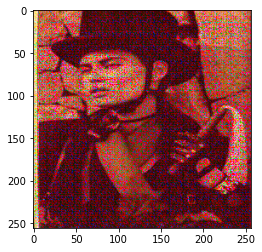

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.7475 - acc: 0.3312
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.7058 - acc: 0.4062
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.7151 - acc: 0.3000
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.5113 - acc: 0.4250
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.7210
Reached epoch: 4


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 21710 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


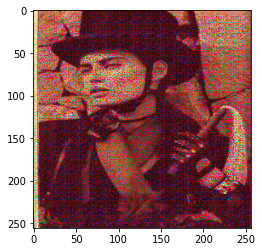

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.7210 - acc: 0.2938
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.4436 - acc: 0.4312
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.5046 - acc: 0.3438
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.4636 - acc: 0.3813
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.7172
Reached epoch: 6


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 22079 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


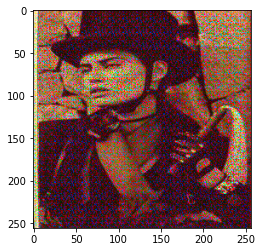

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.5639 - acc: 0.3250
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.4556 - acc: 0.4312
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.6312 - acc: 0.3000
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.4327 - acc: 0.4250
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.8237
Reached epoch: 8


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 20679 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


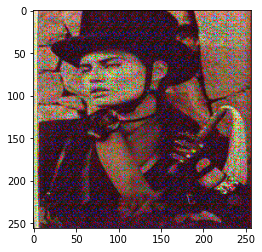

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.4624 - acc: 0.3188
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.1991 - acc: 0.4688
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.4571 - acc: 0.3125
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.3902 - acc: 0.4312
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.5615
Reached epoch: 10


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 19866 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


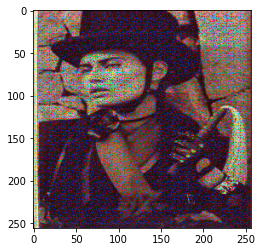

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.3826 - acc: 0.3750
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.2795 - acc: 0.5000
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.5215 - acc: 0.3438
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.2749 - acc: 0.4625
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.4555
Reached epoch: 12


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 18070 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


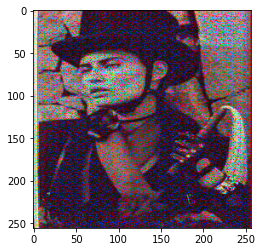

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.4507 - acc: 0.3687
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.3220 - acc: 0.4500
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.3500 - acc: 0.2750
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.3089 - acc: 0.4937
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.5079
Reached epoch: 14


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 17219 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


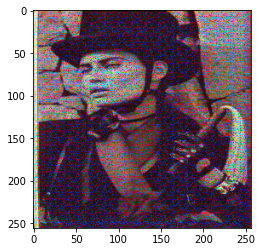

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.4365 - acc: 0.3563
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.1976 - acc: 0.5000
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.2696 - acc: 0.4000
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.1199 - acc: 0.5187
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.6508
Reached epoch: 16


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 18666 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


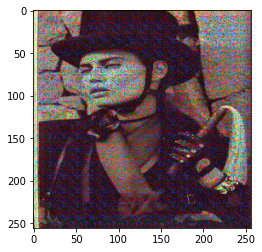

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.5264 - acc: 0.3750
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.2785 - acc: 0.4750
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.4032 - acc: 0.3937
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.1382 - acc: 0.5000
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.5387
Reached epoch: 18


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 19565 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


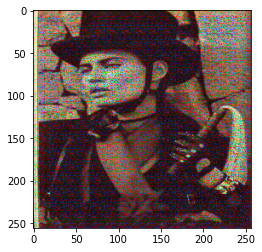

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.3486 - acc: 0.3625
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.2058 - acc: 0.4813
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.4329 - acc: 0.3625
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.2028 - acc: 0.5312
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.7522
Reached epoch: 20


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 20957 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


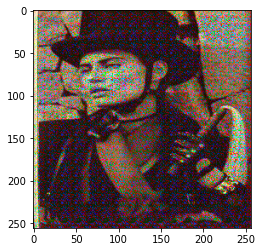

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.2906 - acc: 0.4125
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0752 - acc: 0.5250
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.1059 - acc: 0.4125
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9384 - acc: 0.5312
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.5912
Reached epoch: 22


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 22539 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


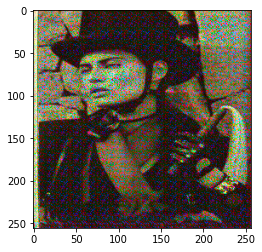

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.1416 - acc: 0.4125
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9810 - acc: 0.5312
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.3031 - acc: 0.3875
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0692 - acc: 0.5000
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.7487
Reached epoch: 24


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 22113 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


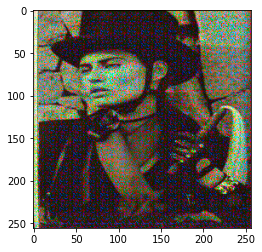

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.2151 - acc: 0.3500
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0309 - acc: 0.5438
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0825 - acc: 0.4375
Epoch 1/1
160/160 [==============================] - 1s 4ms/step - loss: 1.1375 - acc: 0.4688
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.8762
Reached epoch: 26


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 23471 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


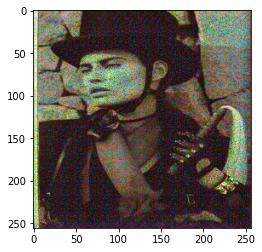

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.3325 - acc: 0.3813
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9955 - acc: 0.5187
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.2773 - acc: 0.4062
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0320 - acc: 0.4937
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.7359
Reached epoch: 28


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 25247 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


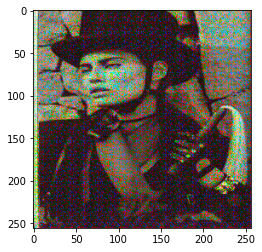

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.1300 - acc: 0.4125
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9450 - acc: 0.5500
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.1075 - acc: 0.4750
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9518 - acc: 0.5500
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.7603
Reached epoch: 30


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 25834 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


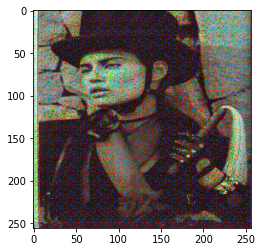

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.2221 - acc: 0.3875
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0257 - acc: 0.5250
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0594 - acc: 0.4000
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9767 - acc: 0.5125
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.6532
Reached epoch: 32


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 28072 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


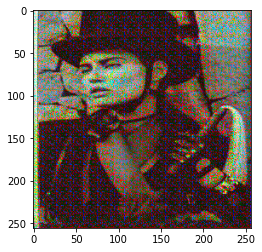

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0715 - acc: 0.4625
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8947 - acc: 0.5750
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.1675 - acc: 0.4188
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9417 - acc: 0.5250
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.3116
Reached epoch: 34


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 30516 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


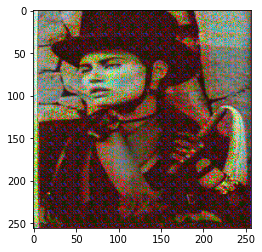

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0542 - acc: 0.4750
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8987 - acc: 0.5750
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.1363 - acc: 0.4438
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8885 - acc: 0.5375
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.5317
Reached epoch: 36


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 29985 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


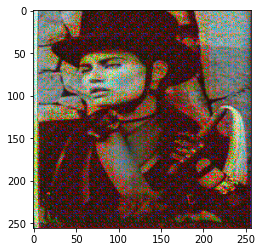

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.1549 - acc: 0.4438
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8905 - acc: 0.5375
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0205 - acc: 0.4500
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9709 - acc: 0.5687
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.2822
Reached epoch: 38


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 29647 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


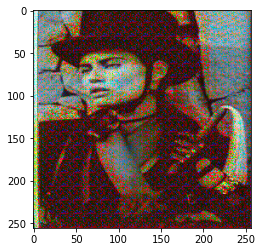

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0254 - acc: 0.4375
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8929 - acc: 0.5563
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.1424 - acc: 0.4312
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9911 - acc: 0.5187
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.3467
Reached epoch: 40


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 29317 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


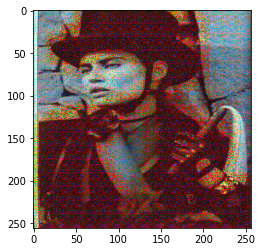

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.1163 - acc: 0.4312
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9798 - acc: 0.5187
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.2032 - acc: 0.4375
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9770 - acc: 0.5250
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.4018
Reached epoch: 42


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 27453 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


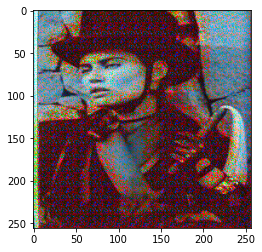

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.1092 - acc: 0.4625
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0598 - acc: 0.5312
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9771 - acc: 0.4875
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0197 - acc: 0.5438
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.3754
Reached epoch: 44


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 27320 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


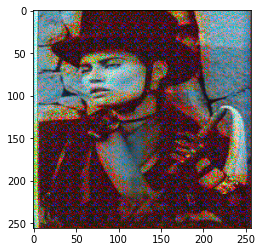

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0548 - acc: 0.4562
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9382 - acc: 0.5938
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0407 - acc: 0.4312
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9966 - acc: 0.5250
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.2082
Reached epoch: 46


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 26193 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


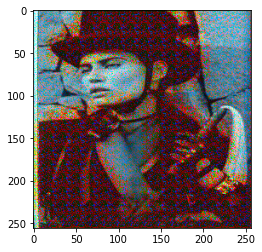

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8801 - acc: 0.5000
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7857 - acc: 0.5500
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0761 - acc: 0.4750
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8495 - acc: 0.6063
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.2033
Reached epoch: 48


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 26233 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


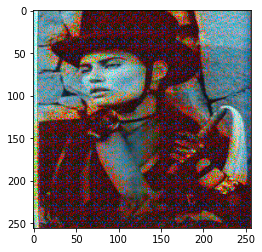

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0176 - acc: 0.4813
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9502 - acc: 0.5375
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9492 - acc: 0.4750
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8947 - acc: 0.4937
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.4012
Reached epoch: 50


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 27699 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


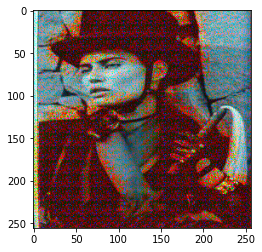

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9893 - acc: 0.5312
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8853 - acc: 0.5938
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0235 - acc: 0.5000
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0452 - acc: 0.5438
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.3608
Reached epoch: 52


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 27616 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


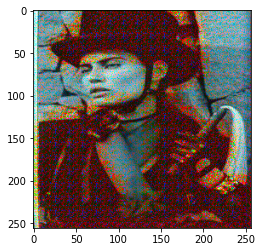

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0245 - acc: 0.5500
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0012 - acc: 0.5500
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0938 - acc: 0.4562
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0178 - acc: 0.5062
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.1853
Reached epoch: 54


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 30525 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


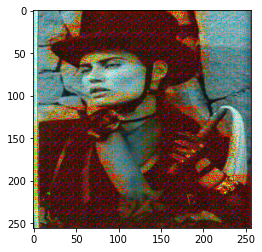

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9941 - acc: 0.4750
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8622 - acc: 0.5687
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9158 - acc: 0.5062
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7998 - acc: 0.6125
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.2053
Reached epoch: 56


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 30258 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


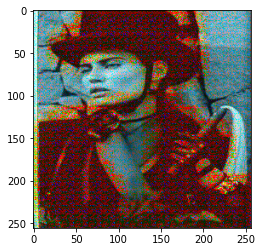

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0216 - acc: 0.4562
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9772 - acc: 0.5312
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.1273 - acc: 0.4937
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8874 - acc: 0.5938
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.1667
Reached epoch: 58


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 28869 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


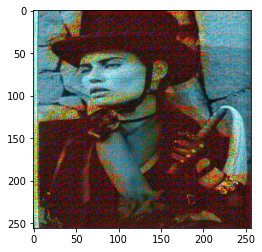

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9745 - acc: 0.5375
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8223 - acc: 0.5438
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9388 - acc: 0.4813
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0046 - acc: 0.5563
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.3145
Reached epoch: 60


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 26637 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


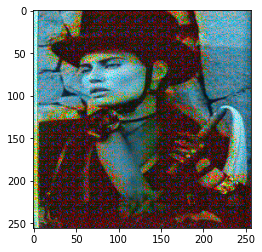

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0058 - acc: 0.4688
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8664 - acc: 0.5625
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9428 - acc: 0.5187
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9308 - acc: 0.4875
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.2442
Reached epoch: 62


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 20912 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


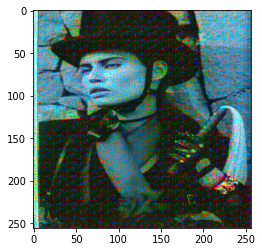

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9017 - acc: 0.4750
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9488 - acc: 0.5563
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0343 - acc: 0.5250
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9038 - acc: 0.5750
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.0046
Reached epoch: 64


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 19047 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


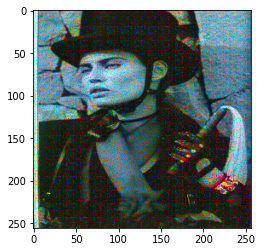

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9234 - acc: 0.5250
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0333 - acc: 0.4750
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8881 - acc: 0.5438
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0252 - acc: 0.4875
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.2222
Reached epoch: 66


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 27021 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


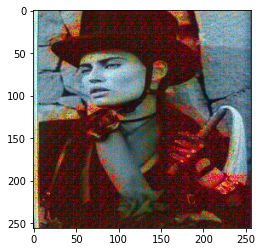

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9709 - acc: 0.5375
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9493 - acc: 0.5625
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 1.0018 - acc: 0.5062
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9813 - acc: 0.5187
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.5132
Reached epoch: 68


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 22829 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


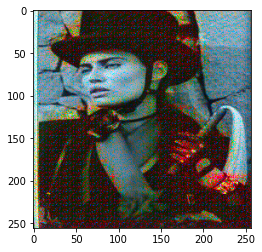

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9606 - acc: 0.5312
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8912 - acc: 0.5312
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9327 - acc: 0.5250
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8965 - acc: 0.5312
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.0659
Reached epoch: 70


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 25732 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


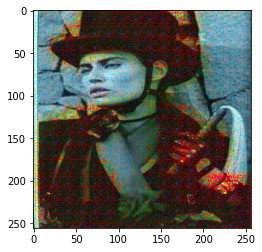

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9398 - acc: 0.5187
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9538 - acc: 0.5812
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8891 - acc: 0.5062
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7465 - acc: 0.5875
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.7677
Reached epoch: 72


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 28554 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


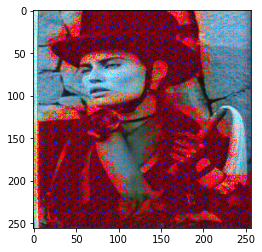

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8225 - acc: 0.5625
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7370 - acc: 0.6375
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7268 - acc: 0.5750
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6066 - acc: 0.7438
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.0396
Reached epoch: 74


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 30553 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


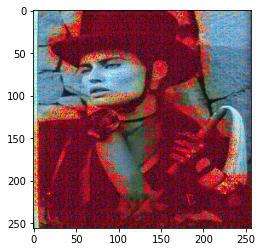

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6039 - acc: 0.7125
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6316 - acc: 0.6937
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6757 - acc: 0.6437
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.5650 - acc: 0.6937
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 0.9761
Reached epoch: 76


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 28906 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


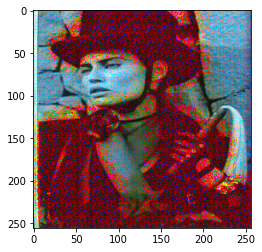

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6114 - acc: 0.7062
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6678 - acc: 0.6500
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6410 - acc: 0.6813
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7752 - acc: 0.6125
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.6313
Reached epoch: 78


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 29352 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


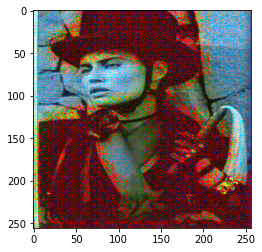

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7191 - acc: 0.6000
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6893 - acc: 0.6813
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6539 - acc: 0.6312
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.5877 - acc: 0.7125
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.3047
Reached epoch: 80


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 26341 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


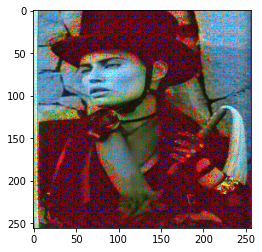

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6946 - acc: 0.6437
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7193 - acc: 0.6188
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8050 - acc: 0.6000
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7374 - acc: 0.7188
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.1377
Reached epoch: 82


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 26610 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


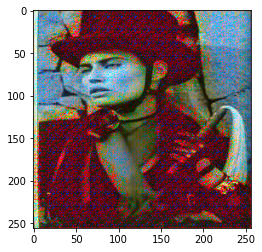

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6087 - acc: 0.7313
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7171 - acc: 0.6875
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7469 - acc: 0.6375
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8526 - acc: 0.5875
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.6064
Reached epoch: 84


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 24894 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


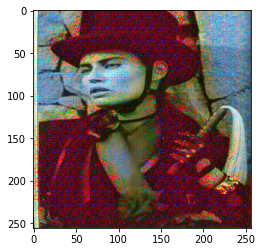

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7905 - acc: 0.6063
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9119 - acc: 0.5625
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7342 - acc: 0.5875
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8357 - acc: 0.6188
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.8388
Reached epoch: 86


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 24631 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


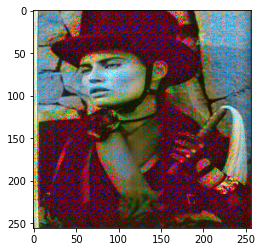

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8643 - acc: 0.5938
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7243 - acc: 0.6125
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 4ms/step - loss: 0.7281 - acc: 0.5875
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8860 - acc: 0.5500
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.0975
Reached epoch: 88


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 27363 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


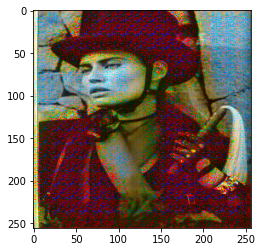

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8406 - acc: 0.5438
Epoch 1/1
160/160 [==============================] - 1s 4ms/step - loss: 0.6675 - acc: 0.6375
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6943 - acc: 0.6063
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8666 - acc: 0.6125
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.1138
Reached epoch: 90


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 30336 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


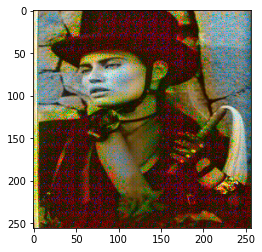

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7985 - acc: 0.5375
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9487 - acc: 0.6063
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9742 - acc: 0.5312
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8644 - acc: 0.5563
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.3803
Reached epoch: 92


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 30883 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


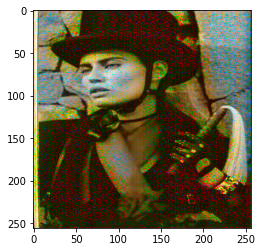

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8721 - acc: 0.5187
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9058 - acc: 0.5438
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8777 - acc: 0.5250
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8138 - acc: 0.5938
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.3200
Reached epoch: 94


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 30748 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


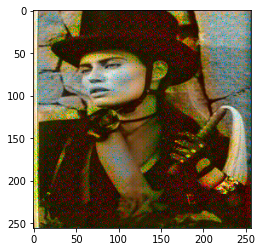

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8164 - acc: 0.5500
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7356 - acc: 0.6250
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7798 - acc: 0.5875
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7718 - acc: 0.6437
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.9342
Reached epoch: 96


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 28917 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


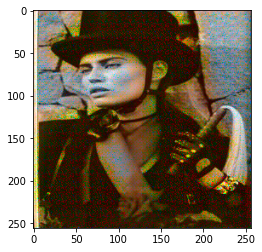

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8144 - acc: 0.5875
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6113 - acc: 0.6750
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6164 - acc: 0.7250
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6342 - acc: 0.6813
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.6268
Reached epoch: 98


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 29063 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


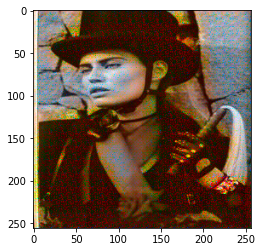

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7451 - acc: 0.6500
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9298 - acc: 0.4937
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8824 - acc: 0.5312
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9877 - acc: 0.5875
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.0078
Reached epoch: 100


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 27217 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


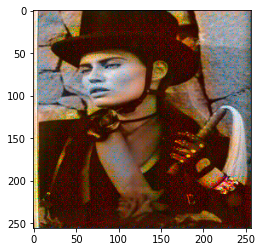

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7484 - acc: 0.5812
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8387 - acc: 0.5750
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8052 - acc: 0.6000
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9293 - acc: 0.5312
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.9812
Reached epoch: 102


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 29062 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


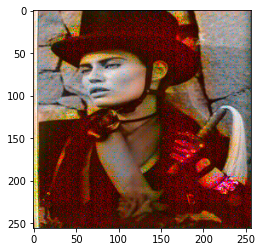

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8582 - acc: 0.5750
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9027 - acc: 0.5438
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8130 - acc: 0.5250
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8885 - acc: 0.5125
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.5010
Reached epoch: 104


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 32369 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


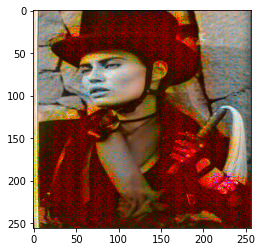

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8849 - acc: 0.5187
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8776 - acc: 0.5250
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.9126 - acc: 0.4875
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8302 - acc: 0.5750
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.0939
Reached epoch: 106


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 31189 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


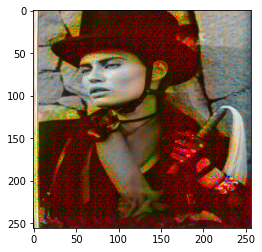

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6807 - acc: 0.6750
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.8009 - acc: 0.5563
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.7725 - acc: 0.5687
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.5538 - acc: 0.7062
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.3324
Reached epoch: 108


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 30545 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


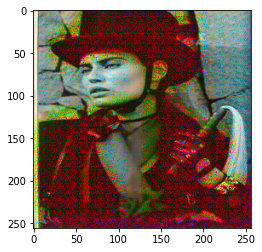

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.5588 - acc: 0.7125
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4951 - acc: 0.7375
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.5604 - acc: 0.7562
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3913 - acc: 0.8312
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.4535
Reached epoch: 110


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 28928 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


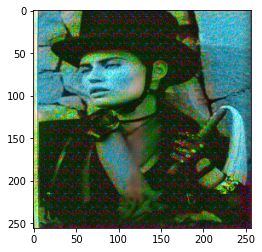

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3842 - acc: 0.8187
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4212 - acc: 0.7938
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3857 - acc: 0.8563
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3141 - acc: 0.8625
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 0.9048
Reached epoch: 112


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 21681 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


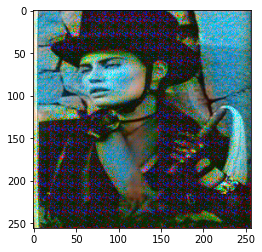

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3400 - acc: 0.8625
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3713 - acc: 0.8438
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3851 - acc: 0.8750
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3101 - acc: 0.8750
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.0206
Reached epoch: 114


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 20514 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


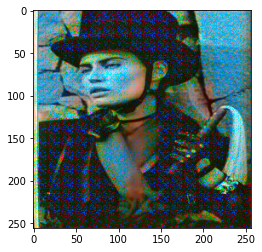

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3094 - acc: 0.8875
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3309 - acc: 0.8563
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3529 - acc: 0.8625
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3491 - acc: 0.8312
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.1661
Reached epoch: 116


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 22007 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


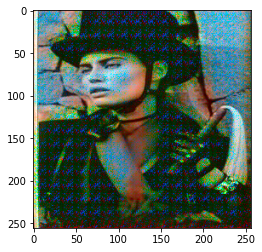

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3610 - acc: 0.8500
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3641 - acc: 0.8375
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4155 - acc: 0.8500
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4044 - acc: 0.8250
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.8298
Reached epoch: 118


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 24289 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


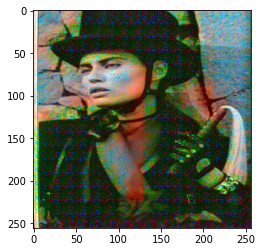

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4313 - acc: 0.8187
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3731 - acc: 0.8375
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3704 - acc: 0.8563
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3572 - acc: 0.8375
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.7116
Reached epoch: 120


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 28101 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


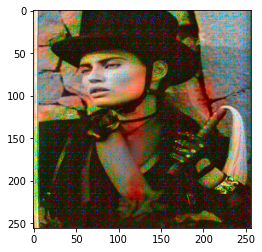

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3441 - acc: 0.8875
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3154 - acc: 0.8625
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4109 - acc: 0.8688
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3675 - acc: 0.8375
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.6738
Reached epoch: 122


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 31906 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


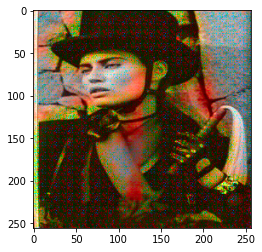

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3528 - acc: 0.8438
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4000 - acc: 0.8000
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4402 - acc: 0.7938
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4826 - acc: 0.7687
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.5175
Reached epoch: 124


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 34509 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


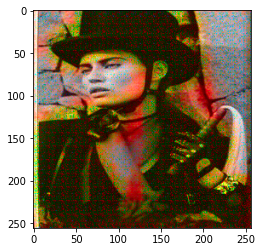

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4921 - acc: 0.7875
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3959 - acc: 0.8063
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4973 - acc: 0.7625
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4494 - acc: 0.7687
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 2.0672
Reached epoch: 126


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 33841 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


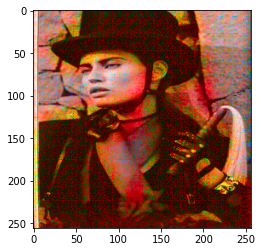

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3944 - acc: 0.8375
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3023 - acc: 0.8625
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3857 - acc: 0.8750
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3218 - acc: 0.8312
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.7109
Reached epoch: 128


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 33154 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


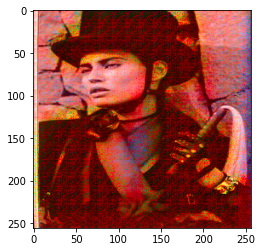

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3470 - acc: 0.8312
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.2550 - acc: 0.9188
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3125 - acc: 0.9000
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.2649 - acc: 0.8812
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.1381
Reached epoch: 130


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 34249 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


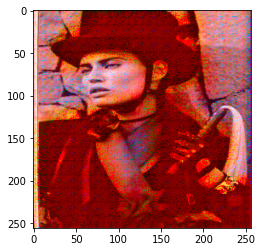

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.2785 - acc: 0.9250
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3751 - acc: 0.8063
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4223 - acc: 0.8688
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3425 - acc: 0.8500
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.3534
Reached epoch: 132


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 32505 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


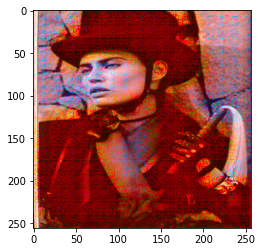

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4489 - acc: 0.8125
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3979 - acc: 0.8187
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4461 - acc: 0.8438
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4453 - acc: 0.7938
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.5086
Reached epoch: 134


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 31696 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


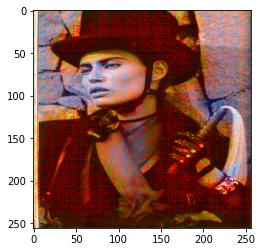

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4217 - acc: 0.8500
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3822 - acc: 0.8250
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4193 - acc: 0.7938
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3931 - acc: 0.8375
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.5833
Reached epoch: 136


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 30053 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


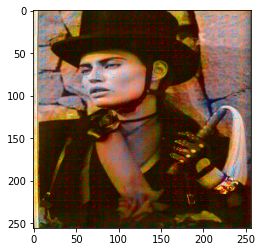

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3683 - acc: 0.8750
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.2469 - acc: 0.9313
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.2829 - acc: 0.9062
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3193 - acc: 0.9062
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.1528
Reached epoch: 138


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 29621 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


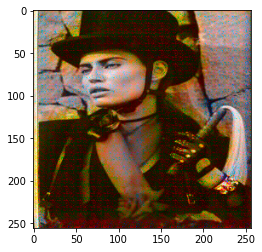

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.2619 - acc: 0.9000
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3146 - acc: 0.8375
Epoch 1/1
160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.3599 - acc: 0.8563
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.4385 - acc: 0.7625
Epoch 1/1
320/320 [==============================] - 7s 21ms/step - loss: 1.8123
Reached epoch: 140


/home/ec2-user/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/skimage/color/colorconv.py:1128: UserWarning: Color data out of range: Z < 0 in 31285 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


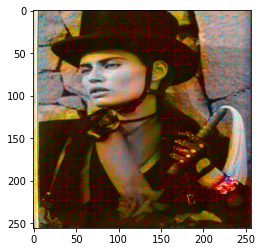

160/160 [==============================] - 1s 7ms/step
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.5315 - acc: 0.8000
Epoch 1/1
160/160 [==============================] - 1s 3ms/step - loss: 0.6455 - acc: 0.7375
Epoch 1/1
128/320 [===========>..................] - ETA: 3s - loss: 2.0157

In [ ]:
############################################################################################
count = 0
for i in range(51):
  count = count + 1  
  X_test_L,X_test_AB,X_train_L,X_train_AB = processing(X_train[i])
 
    #creates lists to log the losses and accuracy
  gen_losses = []
  disc_real_losses = []
  disc_fake_losses=[] 
  disc_acc = []

  #train the generator on a full set of 320 and the discriminator on a half set of 160 for each epoch
  #discriminator is given real and fake y's while generator is always given real y's
  n = 320
  y_train_fake = np.zeros([160,1])
  y_train_real = np.ones([160,1])
  y_gen = np.ones([n,1])

  #Optional label smoothing
  #y_train_real -= .1


  #Pick batch size and number of epochs, number of epochs depends on the number of photos per epoch set above

  num_epochs=1500
  batch_size=32

  from tqdm import tqdm_notebook as tqdm
    #run and train until photos meet expectations (stop & restart model with tweaks if loss goes to 0 in discriminator)
 
  for epoch in tqdm(range(1,num_epochs+1)):
    #shuffle L and AB channels then take a subset corresponding to each networks training size
    np.random.shuffle(X_train_L)
    l = X_train_L[:n]
    np.random.shuffle(X_train_AB)
    ab = X_train_AB[:160]
    
    fake_images = generator.predict(l[:160], verbose=1)
    
    #Train on Real AB channels
    d_loss_real = discriminator.fit(x=ab, y= y_train_real,batch_size=32,epochs=1,verbose=1) 
    disc_real_losses.append(d_loss_real.history['loss'][-1])
    
    #Train on fake AB channels
    d_loss_fake = discriminator.fit(x=fake_images,y=y_train_fake,batch_size=32,epochs=1,verbose=1)
    disc_fake_losses.append(d_loss_fake.history['loss'][-1])
    
    #append the loss and accuracy and print loss
    disc_acc.append(d_loss_fake.history['acc'][-1])
    

    #Train the gan by producing AB channels from L
    g_loss = combined_network.fit(x=l, y=y_gen,batch_size=32,epochs=1,verbose=1)
    #append and print generator loss
    gen_losses.append(g_loss.history['loss'][-1])
    
    #every 50 epochs it prints a generated photo and every 100 it saves the model under that epoch
    if epoch % 2 == 0:
        print('Reached epoch:',epoch)
        pred = generator.predict(X_test_L[2].reshape(1,256,256,1))
        img = lab_to_rgb(np.dstack((X_test_L[2],pred.reshape(256,256,2))))
        plt.imshow(img)
        plt.show()
        if epoch % 10 == 0:
            plt.imsave('outputs/result_epoch=' + str(epoch) + 'batch=' +str(count)+ '_v3.jpg', img)
            #plt.savefig('outputs/result_epoch=' + str(epoch) + 'batch=' +str(count)+ '_v3.jpg')
            generator.save('models/4th_milestone_model_epoch=' + str(epoch) + 'batch=' + str(count)+ '_v3.h5', include_optimizer=True)
    
    #generator.save('/content/drive/My Drive/Working gan model/apna_generator_new_' + str(epoch)+ '_v3.h5', include_optimizer=True)

#############################################################################################################################################